# Question 1: DCGANs

## DCGAN on Stanford Cars Dataset

**Q1.1: Loading the Stanford Cars Dataset**

In [1]:
#download
!pip install -q kaggle
!mkdir ~/.kaggle
!wget https://raw.githubusercontent.com/AnisaAisha/CV_Assignment2/main/kaggle.json
!mv kaggle.json ~/.kaggle
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d jessicali9530/stanford-cars-dataset

--2021-05-29 16:37:06--  https://raw.githubusercontent.com/AnisaAisha/CV_Assignment2/main/kaggle.json
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 65 [text/plain]
Saving to: ‘kaggle.json’

kaggle.json         100%[===================>]      65  --.-KB/s    in 0s      

2021-05-29 16:37:07 (2.99 MB/s) - ‘kaggle.json’ saved [65/65]

100% 1.82G/1.82G [00:12<00:00, 157MB/s]
100% 1.82G/1.82G [00:12<00:00, 160MB/s]


In [2]:
#setup directories
!mkdir CVassignment2/
!mkdir CVassignment2/cars_images

In [3]:
#unzip
import shutil
shutil.unpack_archive("/content/stanford-cars-dataset.zip", "/content/CVassignment2/cars_images")

In [4]:
# we only need the train images 
!rm -r /content/CVassignment2/cars_images/cars_test/
!rm /content/CVassignment2/cars_images/cars_annos*

In [5]:
!mv /content/CVassignment2/cars_images/cars_train/cars_train/*  /content/CVassignment2/cars_images
!rm -r /content/CVassignment2/cars_images/cars_train/

In [6]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

data = ImageDataGenerator(rescale=1./255)

data_generator = data.flow_from_directory(
        '/content/CVassignment2/',
        target_size=(32, 32),
        batch_size=8000,
        class_mode='binary')

Found 8144 images belonging to 1 classes.


In [7]:
images, _ = next(iter(data_generator))
images.shape

(8000, 32, 32, 3)

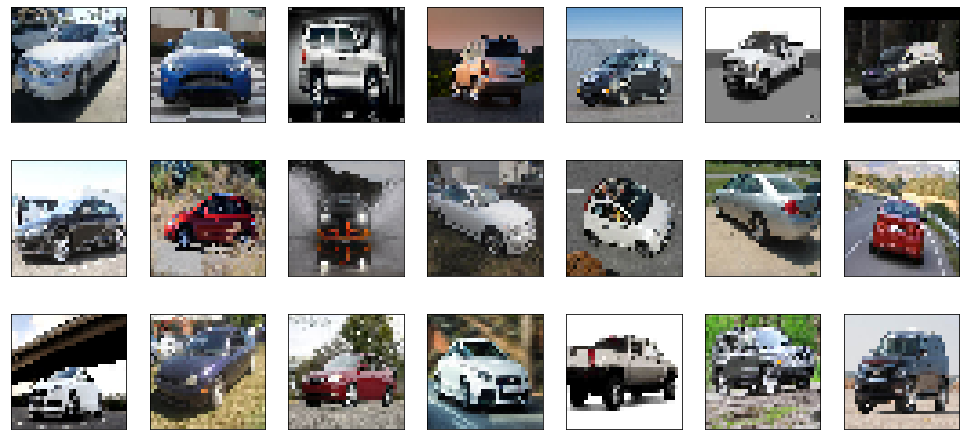

In [19]:
# Visualizing the dataset

import matplotlib.pyplot as plt

#Displaying some samples of the data
fig, axes = plt.subplots(ncols=7, nrows=3, figsize=(17, 8))
index = 0
for i in range(3):
  for j in range(7):
    axes[i,j].imshow(images[index])
    axes[i,j].get_xaxis().set_visible(False)
    axes[i,j].get_yaxis().set_visible(False)
    index += 1
plt.show()

**Pre-processing steps**

Since satisfactory results were not obtained on the original dataset (64x64 RGB images), two types of pre-processing was performed.

 1. Converting the images to grayscale
 2. Resizing the images from (64, 64) to (32, 32). This step was done directly when loading the images from the dataset above.

In [8]:
import cv2
import numpy as np
import tensorflow as tf

images_gray = np.zeros(images.shape[:-1], dtype=images.dtype)
for i, img in enumerate(images):
    images_gray[i] = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

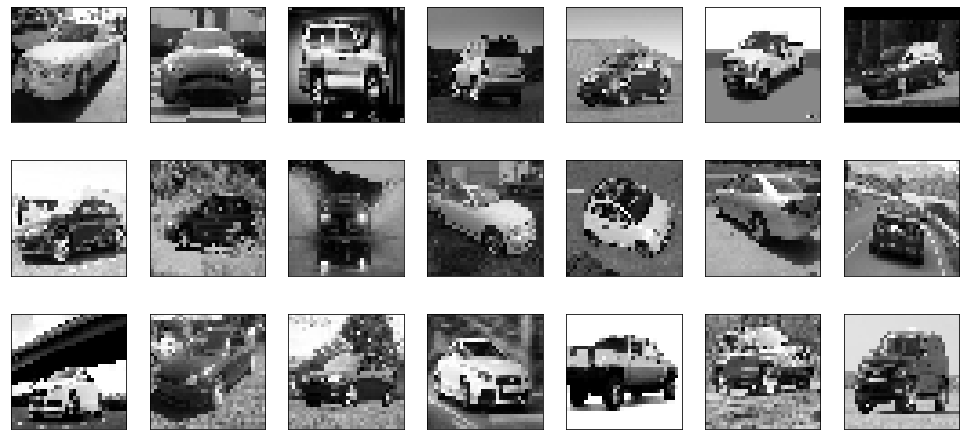

In [21]:
import matplotlib.pyplot as plt

#Displaying some samples of the data
fig, axes = plt.subplots(ncols=7, nrows=3, figsize=(17, 8))
index = 0
for i in range(3):
  for j in range(7):
    #axes[i,j].set_title(labels[y_train[index][0]])
    img = images_gray[index].reshape(32,32)
    axes[i,j].imshow(img, cmap="gray")
    axes[i,j].get_xaxis().set_visible(False)
    axes[i,j].get_yaxis().set_visible(False)
    index += 1
plt.show()

In [9]:
# Expanding dims
images_gray = np.array(tf.expand_dims(images_gray, axis=-1))
images_gray.shape

(8000, 32, 32, 1)

**Q1.2: Implementing CNN based discriminator**

Following code block shows the implemented CNN based discriminator. This architecture was chosen because it gives a nice balance between the losses of discriminator and generator, as the number of filters used in both of them are more or less same.

In [10]:
### FOR STANFORD CARS DATASET

from keras.models import Sequential
from keras.layers import Dense, Conv2D, Flatten, MaxPooling2D, Dropout, LeakyReLU, BatchNormalization, Reshape, Conv2DTranspose, ReLU, Activation, UpSampling2D
from tensorflow.keras import regularizers
from keras.optimizers import Adam, SGD

def discriminator(img_shape):
  model= Sequential()
  model.add(Conv2D(32, kernel_size=(4,4), strides=2, input_shape = img_shape, padding="same"))
  model.add(BatchNormalization(momentum=0.5))
  model.add(LeakyReLU(alpha=0.2))
  model.add(Dropout(0.25))
  model.add(Conv2D(64, kernel_size=(4,4), strides=2, padding="same"))
  model.add(BatchNormalization(momentum=0.5))
  model.add(LeakyReLU(alpha=0.2))
  model.add(Dropout(0.25))
  model.add(Conv2D(128, kernel_size=(4,4), strides=2, padding="same"))
  model.add(BatchNormalization(momentum=0.5))
  model.add(LeakyReLU(alpha=0.2))
  model.add(Dropout(0.25))
  model.add(Conv2D(256, kernel_size=(4,4), strides=2, padding="same"))
  model.add(BatchNormalization(momentum=0.5))
  model.add(LeakyReLU(alpha=0.2))
  model.add(Dropout(0.25))
  model.add(Flatten())
  model.add(Dense(1, activation=('sigmoid')))

  return model

dis = discriminator((images_gray.shape[1], images_gray.shape[2], images_gray.shape[3]))
dis.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 16, 16, 32)        544       
_________________________________________________________________
batch_normalization (BatchNo (None, 16, 16, 32)        128       
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 16, 16, 32)        0         
_________________________________________________________________
dropout (Dropout)            (None, 16, 16, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 8, 8, 64)          32832     
_________________________________________________________________
batch_normalization_1 (Batch (None, 8, 8, 64)          256       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 8, 8, 64)          0

**Q1.3: Implementing Generator**

Following code block shows the generator implemented.

Yes, the dimension of the starting vector can be changed. This would result in a different sampling of the random noise that is generated for the latent vector due to a change in dimension.

In [11]:
### FOR STANFORD CARS DATASET

def generator(imgs, latent_dim = 100):
  model = Sequential()

  model.add(Dense(imgs.shape[1]*imgs.shape[2]*imgs.shape[3], input_dim=latent_dim))
  model.add(Reshape((imgs.shape[1],imgs.shape[2],imgs.shape[3])))
  model.add(Conv2DTranspose(256, kernel_size=(4,4), padding='same'))
  model.add(BatchNormalization(momentum=0.5))
  model.add(ReLU())
  model.add(Conv2DTranspose(256, kernel_size=(4,4), padding='same'))
  model.add(BatchNormalization(momentum=0.5))
  model.add(ReLU())
  model.add(Conv2DTranspose(128, kernel_size=(4,4), padding='same'))
  model.add(BatchNormalization(momentum=0.5))
  model.add(ReLU())
  model.add(Conv2DTranspose(128, kernel_size=(4,4), padding='same'))
  model.add(BatchNormalization(momentum=0.5))
  model.add(ReLU())
  model.add(Conv2DTranspose(imgs.shape[3], kernel_size=(4,4), padding='same'))
  model.add(BatchNormalization(momentum=0.5))
  model.add(Activation("sigmoid"))
  return model

gen = generator(images_gray)
gen.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 1024)              103424    
_________________________________________________________________
reshape (Reshape)            (None, 32, 32, 1)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 32, 32, 256)       4352      
_________________________________________________________________
batch_normalization_4 (Batch (None, 32, 32, 256)       1024      
_________________________________________________________________
re_lu (ReLU)                 (None, 32, 32, 256)       0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 32, 32, 256)       1048832   
_________________________________________________________________
batch_normalization_5 (Batch (None, 32, 32, 256)      

In [12]:
adam = Adam(learning_rate = 0.0002)
adam2 = Adam(learning_rate = 0.00001)
sgd = SGD(learning_rate=0.0001)
dis.compile(optimizer=sgd, loss="binary_crossentropy")
gen.compile(optimizer=adam, loss="binary_crossentropy")

def build_combined_gan(generator, discriminator):
  model = Sequential()
  model.add(generator)
  discriminator.trainable = False
  model.add(discriminator)
  return model

gan = build_combined_gan(gen, dis)
gan.compile(optimizer=adam, loss="binary_crossentropy")
gan.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential_1 (Sequential)    (None, 32, 32, 1)         1948421   
_________________________________________________________________
sequential (Sequential)      (None, 1)                 692065    
Total params: 2,640,486
Trainable params: 1,946,883
Non-trainable params: 693,603
_________________________________________________________________


In [13]:
batch_size = 128
latent_dim = 100

real = np.ones((batch_size, 1))
fake = np.zeros((batch_size, 1))

In [14]:
def normalize(x):
    """
    Normalize a list of sample image data in the range of 0 to 1
    : x: List of image data.  The image shape is (32, 32, 3)
    : return: Numpy array of normalized data
    """
    return np.array((x - np.min(x)) / (np.max(x) - np.min(x)))

**Q1.4: Training loop for GAN**

In [15]:
import matplotlib.pyplot as plt

epochs = 50
history = []
batches_per_epoch = images_gray.shape[0]//batch_size 

print(batches_per_epoch)

for epoch in range(epochs):
  for batch_num in range(batches_per_epoch):
    real_idx = np.random.randint(0, images_gray.shape[0], batch_size)
    real_imgs = images_gray[real_idx]
    noise_latent = np.random.normal(loc=0.0, scale=1.0, size=(batch_size, latent_dim))

    fake_imgs = gen(noise_latent)
    loss_real = dis.train_on_batch(real_imgs, real)
    loss_fake = dis.train_on_batch(fake_imgs, fake)
    discriminator_loss = 0.5 * np.add(loss_real, loss_fake)

    noise_latent = np.random.normal(loc=0.0, scale=1.0, size=(batch_size, latent_dim))
    generator_loss = gan.train_on_batch(noise_latent, real)

    print ("******************Epoch {} Batch {}***************************".format(epoch, batch_num))
    print ("Real Discriminator loss: {}".format(loss_real))
    print ("Fake Discriminator loss: {}".format(loss_fake))
    print ("Full Discriminator loss: {}".format(discriminator_loss))
    print ("Generator loss: {}".format(generator_loss))

    history.append({"Discriminator":discriminator_loss,"Generator":generator_loss}) #can do this by averaging for each batch as well

  #After every epoch, display some generated images
  fig, axes = plt.subplots(ncols=2, nrows=2)
  index = 0
  for i in range(2):
    for j in range(2):
      rand_index = random.randrange(0, len(fake_imgs))
      img = normalize(fake_imgs[rand_index])
      axes[i,j].imshow(img.reshape(32,32), cmap="gray")
      axes[i,j].get_xaxis().set_visible(False)
      axes[i,j].get_yaxis().set_visible(False)
      index += 1
  plt.show()

62
******************Epoch 0 Batch 0***************************
Real Discriminator loss: 0.8318815231323242
Fake Discriminator loss: 0.8576092720031738
Full Discriminator loss: 0.844745397567749
Generator loss: 0.590080976486206
******************Epoch 0 Batch 1***************************
Real Discriminator loss: 0.7946773767471313
Fake Discriminator loss: 0.7884305715560913
Full Discriminator loss: 0.7915539741516113
Generator loss: 0.5344023704528809
******************Epoch 0 Batch 2***************************
Real Discriminator loss: 0.8223005533218384
Fake Discriminator loss: 0.7811508178710938
Full Discriminator loss: 0.8017256855964661
Generator loss: 0.5397430062294006
******************Epoch 0 Batch 3***************************
Real Discriminator loss: 0.7838671207427979
Fake Discriminator loss: 0.8403788208961487
Full Discriminator loss: 0.8121229708194733
Generator loss: 0.6989728808403015
******************Epoch 0 Batch 4***************************
Real Discriminator loss: 0

KeyboardInterrupt: ignored

**Q1.5: Plotting generator and discriminator losses**

In [ ]:
import pandas as pd

def plot_loss(history):
  df = pd.DataFrame(history)
  plt.figure()
  for i in df.columns:
    plt.plot(df[i], label=i)
  plt.legend()
  plt.ylabel("Loss")
  plt.xlabel("Epochs")
  plt.title("Generator and Discriminator Losses")
  plt.show()

plot_loss(history)

**Q1.6: Generate samples function**

In [ ]:
import random 

def generate_samples(n, generated_imgs):
  #Displaying some samples of the data
  fig, axes = plt.subplots(ncols=5, nrows=5, figsize=(17, 8))
  index = 0
  for i in range(5):
    for j in range(5):
      #axes[i,j].set_title(labels[y_train[index][0]])
      rand_index = random.randrange(0, len(generated_imgs))
      #print(rand_index, index)
      img = normalize(generated_imgs[rand_index])
      axes[i,j].imshow(img)
      axes[i,j].get_xaxis().set_visible(False)
      axes[i,j].get_yaxis().set_visible(False)
      index += 1
  plt.show()
  
generate_samples(20, fake_imgs)

## DCGAN on CIFAR-10 Dataset

Since satisfactory results were not obtained on the Stanford Cars dataset, even after applying a grayscale filter and resizing the image, DCGAN was implemented on CIFAR-10 dataset as well. In this case, DCGAN produced good results with sataisfactory fake images.

170508288/170498071 [==============================] - 4s 0us/step


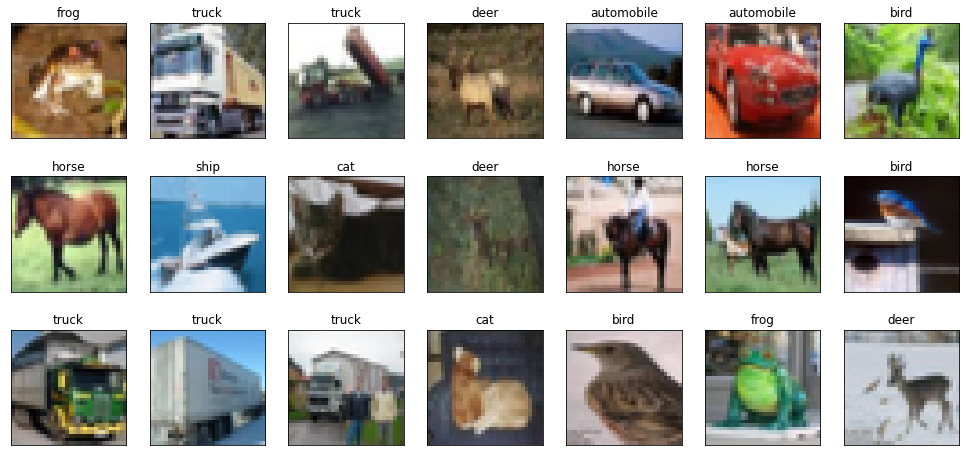

In [1]:
#Loading CIFAR-10 Dataset

from keras.datasets import cifar10
import matplotlib.pyplot as plt

(x_train, y_train), (x_test, y_test) = cifar10.load_data()

#Labels taken from the CIFAR-10 dataset webpage
labels = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck'] 

#Displaying some samples of the data
fig, axes = plt.subplots(ncols=7, nrows=3, figsize=(17, 8))
index = 0
for i in range(3):
  for j in range(7):
    axes[i,j].set_title(labels[y_train[index][0]])
    axes[i,j].imshow(x_train[index])
    axes[i,j].get_xaxis().set_visible(False)
    axes[i,j].get_yaxis().set_visible(False)
    index += 1
plt.show()

In [2]:
cifar10_imgs = x_train
print(cifar10_imgs.shape)

import numpy as np
cifar10_imgs = (cifar10_imgs/255).astype(np.float32)

(50000, 32, 32, 3)


In [3]:
### FOR CIFAR 10 DATASET

from keras.models import Sequential
from keras.layers import Dense, Conv2D, Flatten, MaxPooling2D, Dropout, LeakyReLU, BatchNormalization, Reshape, Conv2DTranspose, ReLU, Activation, UpSampling2D
from tensorflow.keras import regularizers
from keras.optimizers import Adam, SGD

def discriminator(img_shape = (64, 64, 3)):
  model= Sequential()
  model.add(Conv2D(3, kernel_size=(3,3), strides=2, input_shape = img_shape, padding="same"))
  model.add(LeakyReLU(alpha=0.2))
  model.add(Conv2D(64, kernel_size=(3,3), strides=2, padding="same"))
  model.add(LeakyReLU(alpha=0.2))
  model.add(Conv2D(128, kernel_size=(3,3), strides=2, padding="same"))
  model.add(LeakyReLU(alpha=0.2))
  model.add(Conv2D(128, kernel_size=(3,3), strides=2, padding="same"))
  model.add(LeakyReLU(alpha=0.2))
  model.add(Conv2D(256, kernel_size=(3,3), strides=2, padding="same"))
  model.add(LeakyReLU(alpha=0.2))
  model.add(Dropout(0.4))

  model.add(Flatten())
  model.add(Dense(1, activation=('sigmoid')))

  return model

dis = discriminator((cifar10_imgs.shape[1], cifar10_imgs.shape[2], cifar10_imgs.shape[3]))
dis.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 16, 16, 3)         84        
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 16, 16, 3)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 8, 8, 64)          1792      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 8, 8, 64)          0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 4, 4, 128)         73856     
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 4, 4, 128)         0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 2, 2, 128)         1

In [4]:
### FOR CIFAR 10 DATASET

def generator(imgs, latent_dim = 100):
  model = Sequential()

  model.add(Dense(imgs.shape[1]*imgs.shape[2]*imgs.shape[3], input_dim=latent_dim))
  model.add(Reshape((imgs.shape[1],imgs.shape[2],imgs.shape[3])))
  model.add(Conv2DTranspose(128, kernel_size=(3, 3), padding='same'))
  model.add(BatchNormalization(momentum=0.5))
  model.add(ReLU())
  model.add(Conv2DTranspose(128, kernel_size=(3, 3), padding='same'))
  model.add(BatchNormalization(momentum=0.5))
  model.add(ReLU())
  model.add(Conv2DTranspose(128, kernel_size=(3, 3), padding='same'))
  model.add(BatchNormalization(momentum=0.5))
  model.add(ReLU())
  model.add(Conv2DTranspose(3, kernel_size=(3, 3), padding='same'))
  model.add(Activation("sigmoid"))
  return model

gen = generator(cifar10_imgs)
gen.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 3072)              310272    
_________________________________________________________________
reshape (Reshape)            (None, 32, 32, 3)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 32, 32, 128)       3584      
_________________________________________________________________
batch_normalization (BatchNo (None, 32, 32, 128)       512       
_________________________________________________________________
re_lu (ReLU)                 (None, 32, 32, 128)       0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 32, 32, 128)       147584    
_________________________________________________________________
batch_normalization_1 (Batch (None, 32, 32, 128)      

In [5]:
adam = Adam(learning_rate = 0.0002)
dis.compile(optimizer=adam, loss="binary_crossentropy")
gen.compile(optimizer=adam, loss="binary_crossentropy")

def build_combined_gan(generator, discriminator):
  model = Sequential()
  model.add(generator)
  discriminator.trainable = False
  model.add(discriminator)
  return model

gan = build_combined_gan(gen, dis)
gan.compile(optimizer=adam, loss="binary_crossentropy")
gan.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential_1 (Sequential)    (None, 32, 32, 3)         614019    
_________________________________________________________________
sequential (Sequential)      (None, 1)                 518741    
Total params: 1,132,760
Trainable params: 613,251
Non-trainable params: 519,509
_________________________________________________________________


In [6]:
batch_size = 128
latent_dim = 100

real = np.ones((batch_size, 1))
fake = np.zeros((batch_size, 1))

In [7]:
def normalize(x):
    """
    Normalize a list of sample image data in the range of 0 to 1
    : x: List of image data.  The image shape is (32, 32, 3)
    : return: Numpy array of normalized data
    """
    return np.array((x - np.min(x)) / (np.max(x) - np.min(x)))

In [8]:
import random 

#Helper function to generate some samples of data

def generate_samples(n, generated_imgs):
  #Displaying some samples of the data
  fig, axes = plt.subplots(ncols=n, nrows=n)
  index = 0
  for i in range(n):
    for j in range(n):
      rand_index = random.randrange(0, len(generated_imgs))
      img = normalize(generated_imgs[rand_index])
      axes[i,j].imshow(img)
      axes[i,j].get_xaxis().set_visible(False)
      axes[i,j].get_yaxis().set_visible(False)
      index += 1
  plt.show()

390
******************Epoch 0 Batch 0***************************
Real Discriminator loss: 0.6933660507202148
Fake Discriminator loss: 0.6980348825454712
Full Discriminator loss: 0.695700466632843
Generator loss: 0.6852527260780334
******************Epoch 0 Batch 1***************************
Real Discriminator loss: 0.6867914199829102
Fake Discriminator loss: 0.6983261108398438
Full Discriminator loss: 0.692558765411377
Generator loss: 0.6814032793045044
******************Epoch 0 Batch 2***************************
Real Discriminator loss: 0.6847401261329651
Fake Discriminator loss: 0.6989770531654358
Full Discriminator loss: 0.6918585896492004
Generator loss: 0.6752229928970337
******************Epoch 0 Batch 3***************************
Real Discriminator loss: 0.6824323534965515
Fake Discriminator loss: 0.6981433033943176
Full Discriminator loss: 0.6902878284454346
Generator loss: 0.6668992638587952
******************Epoch 0 Batch 4***************************
Real Discriminator loss: 

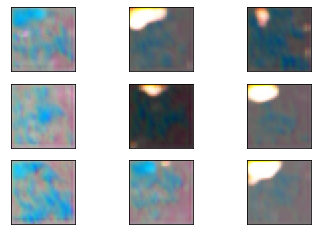

******************Epoch 1 Batch 0***************************
Real Discriminator loss: 0.5152416229248047
Fake Discriminator loss: 0.718987226486206
Full Discriminator loss: 0.6171144247055054
Generator loss: 0.6799078583717346
******************Epoch 1 Batch 1***************************
Real Discriminator loss: 0.46955156326293945
Fake Discriminator loss: 0.7162649035453796
Full Discriminator loss: 0.5929082334041595
Generator loss: 0.7033413052558899
******************Epoch 1 Batch 2***************************
Real Discriminator loss: 0.5023572444915771
Fake Discriminator loss: 0.7262524366378784
Full Discriminator loss: 0.6143048405647278
Generator loss: 0.7380838990211487
******************Epoch 1 Batch 3***************************
Real Discriminator loss: 0.4789015054702759
Fake Discriminator loss: 0.7265757322311401
Full Discriminator loss: 0.602738618850708
Generator loss: 0.6960704326629639
******************Epoch 1 Batch 4***************************
Real Discriminator loss: 0.4

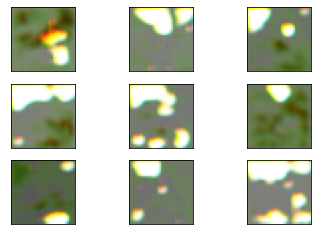

******************Epoch 2 Batch 0***************************
Real Discriminator loss: 0.5604588389396667
Fake Discriminator loss: 0.708280086517334
Full Discriminator loss: 0.6343694627285004
Generator loss: 1.4565973281860352
******************Epoch 2 Batch 1***************************
Real Discriminator loss: 0.5886447429656982
Fake Discriminator loss: 0.7533252835273743
Full Discriminator loss: 0.6709850132465363
Generator loss: 1.6664652824401855
******************Epoch 2 Batch 2***************************
Real Discriminator loss: 0.7781877517700195
Fake Discriminator loss: 0.8544713854789734
Full Discriminator loss: 0.8163295686244965
Generator loss: 1.6821441650390625
******************Epoch 2 Batch 3***************************
Real Discriminator loss: 1.0007737874984741
Fake Discriminator loss: 0.6732052564620972
Full Discriminator loss: 0.8369895219802856
Generator loss: 1.663185954093933
******************Epoch 2 Batch 4***************************
Real Discriminator loss: 1.11

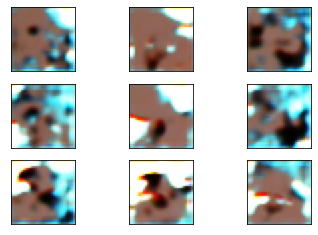

******************Epoch 3 Batch 0***************************
Real Discriminator loss: 0.7398002743721008
Fake Discriminator loss: 0.504457950592041
Full Discriminator loss: 0.6221291124820709
Generator loss: 1.3970730304718018
******************Epoch 3 Batch 1***************************
Real Discriminator loss: 0.8794121742248535
Fake Discriminator loss: 0.4467048645019531
Full Discriminator loss: 0.6630585193634033
Generator loss: 1.2493314743041992
******************Epoch 3 Batch 2***************************
Real Discriminator loss: 0.9231305122375488
Fake Discriminator loss: 0.5121865272521973
Full Discriminator loss: 0.717658519744873
Generator loss: 1.1926624774932861
******************Epoch 3 Batch 3***************************
Real Discriminator loss: 0.860069751739502
Fake Discriminator loss: 0.5141535997390747
Full Discriminator loss: 0.6871116757392883
Generator loss: 1.2443561553955078
******************Epoch 3 Batch 4***************************
Real Discriminator loss: 0.811

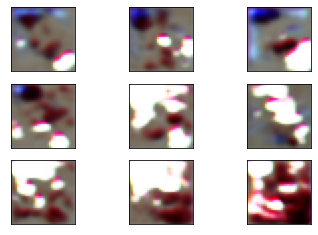

******************Epoch 4 Batch 0***************************
Real Discriminator loss: 0.6224043965339661
Fake Discriminator loss: 0.41616469621658325
Full Discriminator loss: 0.5192845463752747
Generator loss: 1.1371898651123047
******************Epoch 4 Batch 1***************************
Real Discriminator loss: 0.5476586222648621
Fake Discriminator loss: 0.40886789560317993
Full Discriminator loss: 0.478263258934021
Generator loss: 1.3844656944274902
******************Epoch 4 Batch 2***************************
Real Discriminator loss: 0.5590076446533203
Fake Discriminator loss: 0.36209821701049805
Full Discriminator loss: 0.4605529308319092
Generator loss: 1.4257097244262695
******************Epoch 4 Batch 3***************************
Real Discriminator loss: 0.5629274845123291
Fake Discriminator loss: 0.3284267783164978
Full Discriminator loss: 0.44567713141441345
Generator loss: 1.3358986377716064
******************Epoch 4 Batch 4***************************
Real Discriminator loss:

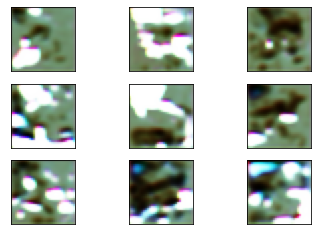

******************Epoch 5 Batch 0***************************
Real Discriminator loss: 0.5381858348846436
Fake Discriminator loss: 0.6590239405632019
Full Discriminator loss: 0.5986048877239227
Generator loss: 0.8078721761703491
******************Epoch 5 Batch 1***************************
Real Discriminator loss: 0.49328720569610596
Fake Discriminator loss: 0.6802018880844116
Full Discriminator loss: 0.5867445468902588
Generator loss: 0.8622057437896729
******************Epoch 5 Batch 2***************************
Real Discriminator loss: 0.47092199325561523
Fake Discriminator loss: 0.6339048147201538
Full Discriminator loss: 0.5524134039878845
Generator loss: 0.8485285043716431
******************Epoch 5 Batch 3***************************
Real Discriminator loss: 0.4654669761657715
Fake Discriminator loss: 0.6283406019210815
Full Discriminator loss: 0.5469037890434265
Generator loss: 0.8528803586959839
******************Epoch 5 Batch 4***************************
Real Discriminator loss: 

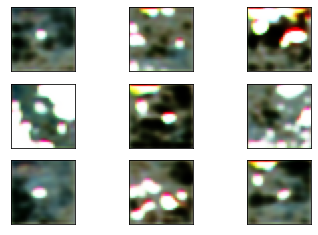

******************Epoch 6 Batch 0***************************
Real Discriminator loss: 0.5971211791038513
Fake Discriminator loss: 0.6408654451370239
Full Discriminator loss: 0.6189933121204376
Generator loss: 0.7640576958656311
******************Epoch 6 Batch 1***************************
Real Discriminator loss: 0.5636553764343262
Fake Discriminator loss: 0.6477161645889282
Full Discriminator loss: 0.6056857705116272
Generator loss: 0.780515193939209
******************Epoch 6 Batch 2***************************
Real Discriminator loss: 0.6024132966995239
Fake Discriminator loss: 0.6602495312690735
Full Discriminator loss: 0.6313314139842987
Generator loss: 0.7807321548461914
******************Epoch 6 Batch 3***************************
Real Discriminator loss: 0.598261296749115
Fake Discriminator loss: 0.669170618057251
Full Discriminator loss: 0.633715957403183
Generator loss: 0.7666193246841431
******************Epoch 6 Batch 4***************************
Real Discriminator loss: 0.6373

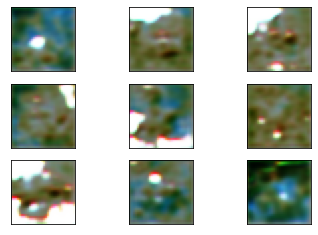

******************Epoch 7 Batch 0***************************
Real Discriminator loss: 0.6457010507583618
Fake Discriminator loss: 1.0263733863830566
Full Discriminator loss: 0.8360372185707092
Generator loss: 0.6130321025848389
******************Epoch 7 Batch 1***************************
Real Discriminator loss: 0.6221225261688232
Fake Discriminator loss: 0.9519137144088745
Full Discriminator loss: 0.7870181202888489
Generator loss: 0.5959035754203796
******************Epoch 7 Batch 2***************************
Real Discriminator loss: 0.6485841274261475
Fake Discriminator loss: 0.8847708106040955
Full Discriminator loss: 0.7666774690151215
Generator loss: 0.5828908085823059
******************Epoch 7 Batch 3***************************
Real Discriminator loss: 0.62997967004776
Fake Discriminator loss: 0.8500779271125793
Full Discriminator loss: 0.7400287985801697
Generator loss: 0.5640782117843628
******************Epoch 7 Batch 4***************************
Real Discriminator loss: 0.58

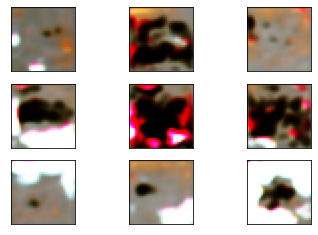

******************Epoch 8 Batch 0***************************
Real Discriminator loss: 0.8124980926513672
Fake Discriminator loss: 0.6225131750106812
Full Discriminator loss: 0.7175056338310242
Generator loss: 0.794462263584137
******************Epoch 8 Batch 1***************************
Real Discriminator loss: 0.8074928522109985
Fake Discriminator loss: 0.6027039289474487
Full Discriminator loss: 0.7050983905792236
Generator loss: 0.7877339720726013
******************Epoch 8 Batch 2***************************
Real Discriminator loss: 0.8040791749954224
Fake Discriminator loss: 0.617870569229126
Full Discriminator loss: 0.7109748721122742
Generator loss: 0.7985035181045532
******************Epoch 8 Batch 3***************************
Real Discriminator loss: 0.781692624092102
Fake Discriminator loss: 0.6048529744148254
Full Discriminator loss: 0.6932727992534637
Generator loss: 0.7863608002662659
******************Epoch 8 Batch 4***************************
Real Discriminator loss: 0.815

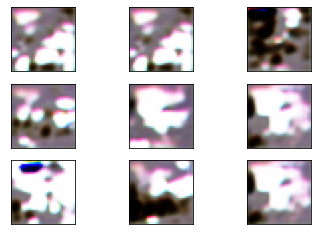

******************Epoch 9 Batch 0***************************
Real Discriminator loss: 1.0979992151260376
Fake Discriminator loss: 0.7931407690048218
Full Discriminator loss: 0.9455699920654297
Generator loss: 0.6941391825675964
******************Epoch 9 Batch 1***************************
Real Discriminator loss: 1.1243127584457397
Fake Discriminator loss: 0.7311651706695557
Full Discriminator loss: 0.9277389645576477
Generator loss: 0.6594069600105286
******************Epoch 9 Batch 2***************************
Real Discriminator loss: 1.081727385520935
Fake Discriminator loss: 0.8425741791725159
Full Discriminator loss: 0.9621507823467255
Generator loss: 0.6559820175170898
******************Epoch 9 Batch 3***************************
Real Discriminator loss: 1.0124684572219849
Fake Discriminator loss: 0.8524791598320007
Full Discriminator loss: 0.9324738085269928
Generator loss: 0.6072206497192383
******************Epoch 9 Batch 4***************************
Real Discriminator loss: 0.9

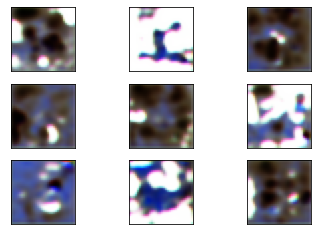

******************Epoch 10 Batch 0***************************
Real Discriminator loss: 0.9145128130912781
Fake Discriminator loss: 0.5087544918060303
Full Discriminator loss: 0.7116336524486542
Generator loss: 0.957413911819458
******************Epoch 10 Batch 1***************************
Real Discriminator loss: 0.8574209213256836
Fake Discriminator loss: 0.5717171430587769
Full Discriminator loss: 0.7145690321922302
Generator loss: 0.9859960675239563
******************Epoch 10 Batch 2***************************
Real Discriminator loss: 0.8699079751968384
Fake Discriminator loss: 0.5527153611183167
Full Discriminator loss: 0.7113116681575775
Generator loss: 0.962290346622467
******************Epoch 10 Batch 3***************************
Real Discriminator loss: 0.8991737365722656
Fake Discriminator loss: 0.5364211797714233
Full Discriminator loss: 0.7177974581718445
Generator loss: 0.9508309364318848
******************Epoch 10 Batch 4***************************
Real Discriminator loss:

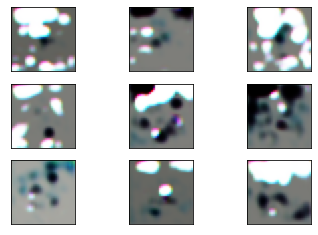

******************Epoch 11 Batch 0***************************
Real Discriminator loss: 0.6524537801742554
Fake Discriminator loss: 0.37949541211128235
Full Discriminator loss: 0.5159745961427689
Generator loss: 1.4003963470458984
******************Epoch 11 Batch 1***************************
Real Discriminator loss: 0.5808615684509277
Fake Discriminator loss: 0.3997379541397095
Full Discriminator loss: 0.4902997612953186
Generator loss: 1.4354788064956665
******************Epoch 11 Batch 2***************************
Real Discriminator loss: 0.5801680088043213
Fake Discriminator loss: 0.38950610160827637
Full Discriminator loss: 0.48483705520629883
Generator loss: 1.4490101337432861
******************Epoch 11 Batch 3***************************
Real Discriminator loss: 0.6213539242744446
Fake Discriminator loss: 0.35224074125289917
Full Discriminator loss: 0.4867973327636719
Generator loss: 1.5138216018676758
******************Epoch 11 Batch 4***************************
Real Discriminator

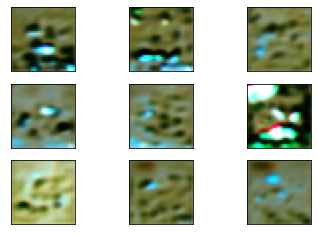

******************Epoch 12 Batch 0***************************
Real Discriminator loss: 0.41033458709716797
Fake Discriminator loss: 0.42017775774002075
Full Discriminator loss: 0.41525617241859436
Generator loss: 1.234683871269226
******************Epoch 12 Batch 1***************************
Real Discriminator loss: 0.3482753038406372
Fake Discriminator loss: 0.4722132980823517
Full Discriminator loss: 0.41024430096149445
Generator loss: 1.192853569984436
******************Epoch 12 Batch 2***************************
Real Discriminator loss: 0.4132876992225647
Fake Discriminator loss: 0.4319643974304199
Full Discriminator loss: 0.4226260483264923
Generator loss: 1.1757296323776245
******************Epoch 12 Batch 3***************************
Real Discriminator loss: 0.4152698516845703
Fake Discriminator loss: 0.46913862228393555
Full Discriminator loss: 0.44220423698425293
Generator loss: 1.0479938983917236
******************Epoch 12 Batch 4***************************
Real Discriminator

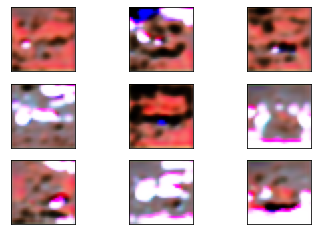

******************Epoch 13 Batch 0***************************
Real Discriminator loss: 0.30205661058425903
Fake Discriminator loss: 0.5149353742599487
Full Discriminator loss: 0.4084959924221039
Generator loss: 0.9640259146690369
******************Epoch 13 Batch 1***************************
Real Discriminator loss: 0.2573511600494385
Fake Discriminator loss: 0.4928722083568573
Full Discriminator loss: 0.3751116842031479
Generator loss: 0.9996823668479919
******************Epoch 13 Batch 2***************************
Real Discriminator loss: 0.2630766034126282
Fake Discriminator loss: 0.4942978024482727
Full Discriminator loss: 0.37868720293045044
Generator loss: 1.0158835649490356
******************Epoch 13 Batch 3***************************
Real Discriminator loss: 0.25555118918418884
Fake Discriminator loss: 0.4871491491794586
Full Discriminator loss: 0.37135016918182373
Generator loss: 1.0636882781982422
******************Epoch 13 Batch 4***************************
Real Discriminator

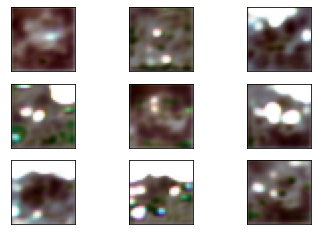

******************Epoch 14 Batch 0***************************
Real Discriminator loss: 0.5639498233795166
Fake Discriminator loss: 0.49956512451171875
Full Discriminator loss: 0.5317574739456177
Generator loss: 1.05214262008667
******************Epoch 14 Batch 1***************************
Real Discriminator loss: 0.5410999059677124
Fake Discriminator loss: 0.5744417905807495
Full Discriminator loss: 0.557770848274231
Generator loss: 1.0273544788360596
******************Epoch 14 Batch 2***************************
Real Discriminator loss: 0.47753798961639404
Fake Discriminator loss: 0.5563998222351074
Full Discriminator loss: 0.5169689059257507
Generator loss: 0.9651191234588623
******************Epoch 14 Batch 3***************************
Real Discriminator loss: 0.47184598445892334
Fake Discriminator loss: 0.690872073173523
Full Discriminator loss: 0.5813590288162231
Generator loss: 1.0328412055969238
******************Epoch 14 Batch 4***************************
Real Discriminator loss

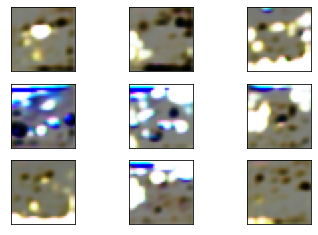

******************Epoch 15 Batch 0***************************
Real Discriminator loss: 0.47723743319511414
Fake Discriminator loss: 0.4226500988006592
Full Discriminator loss: 0.44994376599788666
Generator loss: 1.2196438312530518
******************Epoch 15 Batch 1***************************
Real Discriminator loss: 0.5726320147514343
Fake Discriminator loss: 0.4322601854801178
Full Discriminator loss: 0.5024461001157761
Generator loss: 1.3015811443328857
******************Epoch 15 Batch 2***************************
Real Discriminator loss: 0.5738550424575806
Fake Discriminator loss: 0.5064416527748108
Full Discriminator loss: 0.5401483476161957
Generator loss: 1.1339592933654785
******************Epoch 15 Batch 3***************************
Real Discriminator loss: 0.47038620710372925
Fake Discriminator loss: 0.5581420063972473
Full Discriminator loss: 0.5142641067504883
Generator loss: 1.1115576028823853
******************Epoch 15 Batch 4***************************
Real Discriminator 

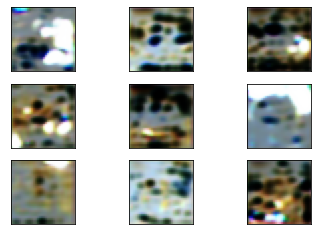

******************Epoch 16 Batch 0***************************
Real Discriminator loss: 0.5935319066047668
Fake Discriminator loss: 0.6694790720939636
Full Discriminator loss: 0.6315054893493652
Generator loss: 0.7660508751869202
******************Epoch 16 Batch 1***************************
Real Discriminator loss: 0.5907363295555115
Fake Discriminator loss: 0.6912501454353333
Full Discriminator loss: 0.6409932374954224
Generator loss: 0.7928593158721924
******************Epoch 16 Batch 2***************************
Real Discriminator loss: 0.5526429414749146
Fake Discriminator loss: 0.649561882019043
Full Discriminator loss: 0.6011024117469788
Generator loss: 0.7614995241165161
******************Epoch 16 Batch 3***************************
Real Discriminator loss: 0.5525271892547607
Fake Discriminator loss: 0.7143835425376892
Full Discriminator loss: 0.633455365896225
Generator loss: 0.7526674270629883
******************Epoch 16 Batch 4***************************
Real Discriminator loss:

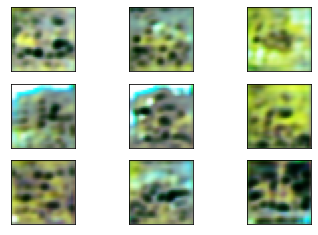

******************Epoch 17 Batch 0***************************
Real Discriminator loss: 0.2523925304412842
Fake Discriminator loss: 0.48257458209991455
Full Discriminator loss: 0.36748355627059937
Generator loss: 1.0870378017425537
******************Epoch 17 Batch 1***************************
Real Discriminator loss: 0.2808271050453186
Fake Discriminator loss: 0.5931644439697266
Full Discriminator loss: 0.4369957745075226
Generator loss: 1.1707441806793213
******************Epoch 17 Batch 2***************************
Real Discriminator loss: 0.26899969577789307
Fake Discriminator loss: 0.570060133934021
Full Discriminator loss: 0.41952991485595703
Generator loss: 1.2410978078842163
******************Epoch 17 Batch 3***************************
Real Discriminator loss: 0.2094893902540207
Fake Discriminator loss: 0.4448692500591278
Full Discriminator loss: 0.32717932015657425
Generator loss: 1.2272449731826782
******************Epoch 17 Batch 4***************************
Real Discriminator

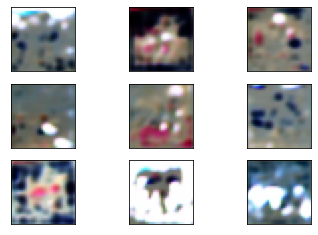

******************Epoch 18 Batch 0***************************
Real Discriminator loss: 0.5742000341415405
Fake Discriminator loss: 0.4921816289424896
Full Discriminator loss: 0.5331908315420151
Generator loss: 1.032865047454834
******************Epoch 18 Batch 1***************************
Real Discriminator loss: 0.5725464820861816
Fake Discriminator loss: 0.4963160753250122
Full Discriminator loss: 0.5344312787055969
Generator loss: 1.0365214347839355
******************Epoch 18 Batch 2***************************
Real Discriminator loss: 0.543785572052002
Fake Discriminator loss: 0.494249165058136
Full Discriminator loss: 0.519017368555069
Generator loss: 1.028660774230957
******************Epoch 18 Batch 3***************************
Real Discriminator loss: 0.597361147403717
Fake Discriminator loss: 0.5428364276885986
Full Discriminator loss: 0.5700987875461578
Generator loss: 1.034406304359436
******************Epoch 18 Batch 4***************************
Real Discriminator loss: 0.64

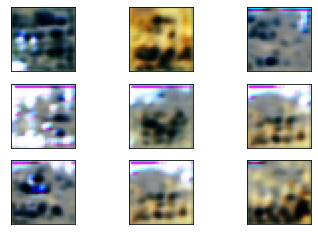

******************Epoch 19 Batch 0***************************
Real Discriminator loss: 0.6662483811378479
Fake Discriminator loss: 0.7233251333236694
Full Discriminator loss: 0.6947867572307587
Generator loss: 0.6595718860626221
******************Epoch 19 Batch 1***************************
Real Discriminator loss: 0.6610302329063416
Fake Discriminator loss: 0.7328164577484131
Full Discriminator loss: 0.6969233453273773
Generator loss: 0.6642215251922607
******************Epoch 19 Batch 2***************************
Real Discriminator loss: 0.6738672256469727
Fake Discriminator loss: 0.735329806804657
Full Discriminator loss: 0.7045985162258148
Generator loss: 0.6551027297973633
******************Epoch 19 Batch 3***************************
Real Discriminator loss: 0.6413554549217224
Fake Discriminator loss: 0.7444716691970825
Full Discriminator loss: 0.6929135620594025
Generator loss: 0.660944938659668
******************Epoch 19 Batch 4***************************
Real Discriminator loss:

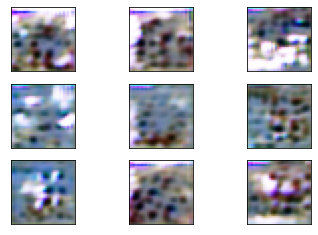

******************Epoch 20 Batch 0***************************
Real Discriminator loss: 0.7574225664138794
Fake Discriminator loss: 0.6170634031295776
Full Discriminator loss: 0.6872429847717285
Generator loss: 0.7845609784126282
******************Epoch 20 Batch 1***************************
Real Discriminator loss: 0.7498615384101868
Fake Discriminator loss: 0.6316708326339722
Full Discriminator loss: 0.6907661855220795
Generator loss: 0.7986266613006592
******************Epoch 20 Batch 2***************************
Real Discriminator loss: 0.7305779457092285
Fake Discriminator loss: 0.6261305212974548
Full Discriminator loss: 0.6783542335033417
Generator loss: 0.785524845123291
******************Epoch 20 Batch 3***************************
Real Discriminator loss: 0.736224353313446
Fake Discriminator loss: 0.6331097483634949
Full Discriminator loss: 0.6846670508384705
Generator loss: 0.8286847472190857
******************Epoch 20 Batch 4***************************
Real Discriminator loss:

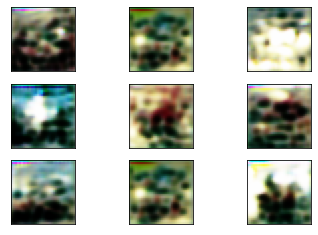

******************Epoch 21 Batch 0***************************
Real Discriminator loss: 0.7060691118240356
Fake Discriminator loss: 0.7519580125808716
Full Discriminator loss: 0.7290135622024536
Generator loss: 0.630456805229187
******************Epoch 21 Batch 1***************************
Real Discriminator loss: 0.700437605381012
Fake Discriminator loss: 0.7728598713874817
Full Discriminator loss: 0.7366487383842468
Generator loss: 0.6260830163955688
******************Epoch 21 Batch 2***************************
Real Discriminator loss: 0.6942040920257568
Fake Discriminator loss: 0.7581407427787781
Full Discriminator loss: 0.7261724174022675
Generator loss: 0.6368401646614075
******************Epoch 21 Batch 3***************************
Real Discriminator loss: 0.6826132535934448
Fake Discriminator loss: 0.7583051919937134
Full Discriminator loss: 0.7204592227935791
Generator loss: 0.6687968969345093
******************Epoch 21 Batch 4***************************
Real Discriminator loss:

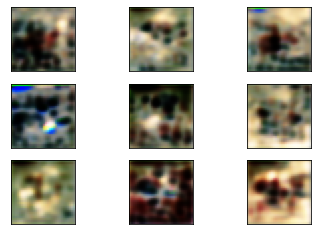

******************Epoch 22 Batch 0***************************
Real Discriminator loss: 0.7419794797897339
Fake Discriminator loss: 0.761532723903656
Full Discriminator loss: 0.751756101846695
Generator loss: 0.7028176784515381
******************Epoch 22 Batch 1***************************
Real Discriminator loss: 0.7938334941864014
Fake Discriminator loss: 0.7661288380622864
Full Discriminator loss: 0.7799811661243439
Generator loss: 0.7096477150917053
******************Epoch 22 Batch 2***************************
Real Discriminator loss: 0.7623720765113831
Fake Discriminator loss: 0.6938132047653198
Full Discriminator loss: 0.7280926406383514
Generator loss: 0.7304539680480957
******************Epoch 22 Batch 3***************************
Real Discriminator loss: 0.7955119609832764
Fake Discriminator loss: 0.6936794519424438
Full Discriminator loss: 0.7445957064628601
Generator loss: 0.7325520515441895
******************Epoch 22 Batch 4***************************
Real Discriminator loss:

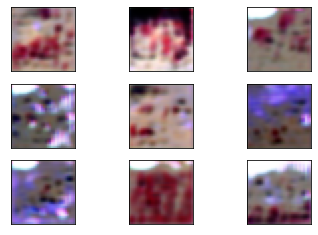

******************Epoch 23 Batch 0***************************
Real Discriminator loss: 0.7432970404624939
Fake Discriminator loss: 0.633342981338501
Full Discriminator loss: 0.6883200109004974
Generator loss: 0.8170881867408752
******************Epoch 23 Batch 1***************************
Real Discriminator loss: 0.7227736115455627
Fake Discriminator loss: 0.6003990769386292
Full Discriminator loss: 0.661586344242096
Generator loss: 0.7960399985313416
******************Epoch 23 Batch 2***************************
Real Discriminator loss: 0.7146323919296265
Fake Discriminator loss: 0.6123553514480591
Full Discriminator loss: 0.6634938716888428
Generator loss: 0.8121770620346069
******************Epoch 23 Batch 3***************************
Real Discriminator loss: 0.7044495344161987
Fake Discriminator loss: 0.6225712299346924
Full Discriminator loss: 0.6635103821754456
Generator loss: 0.7791168689727783
******************Epoch 23 Batch 4***************************
Real Discriminator loss:

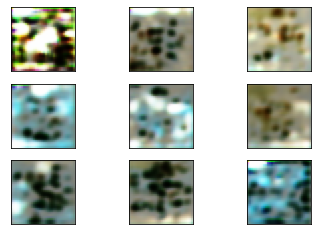

******************Epoch 24 Batch 0***************************
Real Discriminator loss: 0.6528612375259399
Fake Discriminator loss: 0.6850802898406982
Full Discriminator loss: 0.6689707636833191
Generator loss: 0.7359451055526733
******************Epoch 24 Batch 1***************************
Real Discriminator loss: 0.6411333084106445
Fake Discriminator loss: 0.6755108833312988
Full Discriminator loss: 0.6583220958709717
Generator loss: 0.7383090853691101
******************Epoch 24 Batch 2***************************
Real Discriminator loss: 0.6503089666366577
Fake Discriminator loss: 0.6806657314300537
Full Discriminator loss: 0.6654873490333557
Generator loss: 0.7334291934967041
******************Epoch 24 Batch 3***************************
Real Discriminator loss: 0.6313821077346802
Fake Discriminator loss: 0.6541124582290649
Full Discriminator loss: 0.6427472829818726
Generator loss: 0.7282124161720276
******************Epoch 24 Batch 4***************************
Real Discriminator los

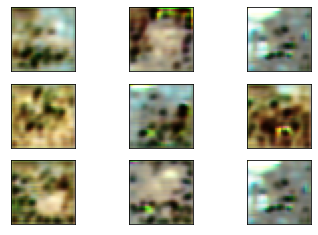

******************Epoch 25 Batch 0***************************
Real Discriminator loss: 0.7063419818878174
Fake Discriminator loss: 0.7323570251464844
Full Discriminator loss: 0.7193495035171509
Generator loss: 0.6892341375350952
******************Epoch 25 Batch 1***************************
Real Discriminator loss: 0.7101048231124878
Fake Discriminator loss: 0.7024239301681519
Full Discriminator loss: 0.7062643766403198
Generator loss: 0.6757157444953918
******************Epoch 25 Batch 2***************************
Real Discriminator loss: 0.7113390564918518
Fake Discriminator loss: 0.7092599868774414
Full Discriminator loss: 0.7102995216846466
Generator loss: 0.6726541519165039
******************Epoch 25 Batch 3***************************
Real Discriminator loss: 0.7038666605949402
Fake Discriminator loss: 0.7276508808135986
Full Discriminator loss: 0.7157587707042694
Generator loss: 0.6830981373786926
******************Epoch 25 Batch 4***************************
Real Discriminator los

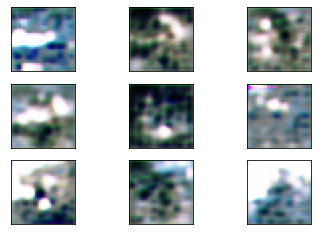

******************Epoch 26 Batch 0***************************
Real Discriminator loss: 0.4288911819458008
Fake Discriminator loss: 0.6590242385864258
Full Discriminator loss: 0.5439577102661133
Generator loss: 0.7982494831085205
******************Epoch 26 Batch 1***************************
Real Discriminator loss: 0.478191077709198
Fake Discriminator loss: 0.624535083770752
Full Discriminator loss: 0.551363080739975
Generator loss: 0.7938212156295776
******************Epoch 26 Batch 2***************************
Real Discriminator loss: 0.4624500870704651
Fake Discriminator loss: 0.5898871421813965
Full Discriminator loss: 0.5261686146259308
Generator loss: 0.830796480178833
******************Epoch 26 Batch 3***************************
Real Discriminator loss: 0.4679392874240875
Fake Discriminator loss: 0.6153510808944702
Full Discriminator loss: 0.5416451841592789
Generator loss: 0.8346239924430847
******************Epoch 26 Batch 4***************************
Real Discriminator loss: 0

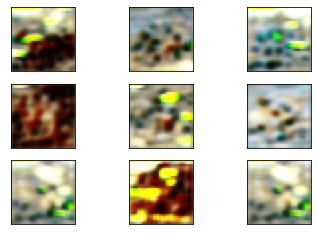

******************Epoch 27 Batch 0***************************
Real Discriminator loss: 0.5314784646034241
Fake Discriminator loss: 0.7506295442581177
Full Discriminator loss: 0.6410540044307709
Generator loss: 0.7083988189697266
******************Epoch 27 Batch 1***************************
Real Discriminator loss: 0.546256959438324
Fake Discriminator loss: 0.7346367835998535
Full Discriminator loss: 0.6404468715190887
Generator loss: 0.7368391752243042
******************Epoch 27 Batch 2***************************
Real Discriminator loss: 0.5640316009521484
Fake Discriminator loss: 0.7509762048721313
Full Discriminator loss: 0.6575039029121399
Generator loss: 0.7048321962356567
******************Epoch 27 Batch 3***************************
Real Discriminator loss: 0.5885618329048157
Fake Discriminator loss: 0.7748039364814758
Full Discriminator loss: 0.6816828846931458
Generator loss: 0.7891154289245605
******************Epoch 27 Batch 4***************************
Real Discriminator loss

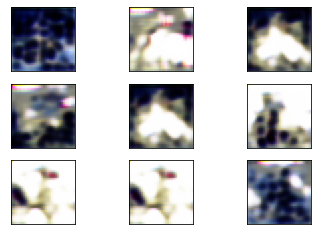

******************Epoch 28 Batch 0***************************
Real Discriminator loss: 0.642108142375946
Fake Discriminator loss: 0.6359286904335022
Full Discriminator loss: 0.6390184164047241
Generator loss: 1.0388588905334473
******************Epoch 28 Batch 1***************************
Real Discriminator loss: 0.684555172920227
Fake Discriminator loss: 0.6142077445983887
Full Discriminator loss: 0.6493814587593079
Generator loss: 1.0208827257156372
******************Epoch 28 Batch 2***************************
Real Discriminator loss: 0.7101802229881287
Fake Discriminator loss: 0.5370174050331116
Full Discriminator loss: 0.6235988140106201
Generator loss: 1.0913358926773071
******************Epoch 28 Batch 3***************************
Real Discriminator loss: 0.6783980131149292
Fake Discriminator loss: 0.592612087726593
Full Discriminator loss: 0.6355050504207611
Generator loss: 1.0878276824951172
******************Epoch 28 Batch 4***************************
Real Discriminator loss: 

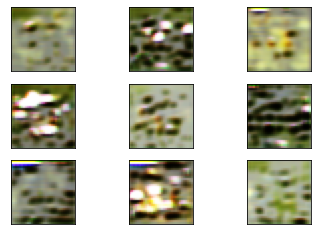

******************Epoch 29 Batch 0***************************
Real Discriminator loss: 0.8281025886535645
Fake Discriminator loss: 0.3428718149662018
Full Discriminator loss: 0.5854872018098831
Generator loss: 1.2976834774017334
******************Epoch 29 Batch 1***************************
Real Discriminator loss: 0.787471354007721
Fake Discriminator loss: 0.3446537256240845
Full Discriminator loss: 0.5660625398159027
Generator loss: 1.270399808883667
******************Epoch 29 Batch 2***************************
Real Discriminator loss: 0.7647111415863037
Fake Discriminator loss: 0.39266538619995117
Full Discriminator loss: 0.5786882638931274
Generator loss: 1.150341510772705
******************Epoch 29 Batch 3***************************
Real Discriminator loss: 0.7514913082122803
Fake Discriminator loss: 0.4161672294139862
Full Discriminator loss: 0.5838292688131332
Generator loss: 1.1305909156799316
******************Epoch 29 Batch 4***************************
Real Discriminator loss:

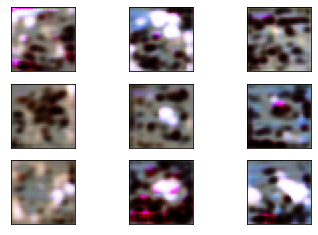

******************Epoch 30 Batch 0***************************
Real Discriminator loss: 0.9951989650726318
Fake Discriminator loss: 0.6519763469696045
Full Discriminator loss: 0.8235876560211182
Generator loss: 0.8291699886322021
******************Epoch 30 Batch 1***************************
Real Discriminator loss: 0.95928555727005
Fake Discriminator loss: 0.5983192920684814
Full Discriminator loss: 0.7788024246692657
Generator loss: 0.7905217409133911
******************Epoch 30 Batch 2***************************
Real Discriminator loss: 0.9335849285125732
Fake Discriminator loss: 0.6126897931098938
Full Discriminator loss: 0.7731373608112335
Generator loss: 0.8377180099487305
******************Epoch 30 Batch 3***************************
Real Discriminator loss: 0.979519248008728
Fake Discriminator loss: 0.5951559543609619
Full Discriminator loss: 0.787337601184845
Generator loss: 0.8736778497695923
******************Epoch 30 Batch 4***************************
Real Discriminator loss: 0

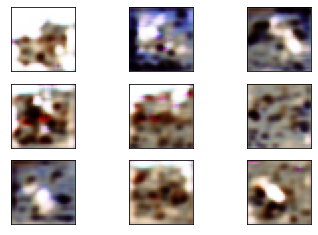

******************Epoch 31 Batch 0***************************
Real Discriminator loss: 0.5142415761947632
Fake Discriminator loss: 0.6303895711898804
Full Discriminator loss: 0.5723155736923218
Generator loss: 0.9988312125205994
******************Epoch 31 Batch 1***************************
Real Discriminator loss: 0.6215642690658569
Fake Discriminator loss: 0.6424863934516907
Full Discriminator loss: 0.6320253312587738
Generator loss: 0.9225701093673706
******************Epoch 31 Batch 2***************************
Real Discriminator loss: 0.5920230746269226
Fake Discriminator loss: 0.6863414645195007
Full Discriminator loss: 0.6391822695732117
Generator loss: 0.9356166124343872
******************Epoch 31 Batch 3***************************
Real Discriminator loss: 0.626456618309021
Fake Discriminator loss: 0.6419180631637573
Full Discriminator loss: 0.6341873407363892
Generator loss: 0.8820947408676147
******************Epoch 31 Batch 4***************************
Real Discriminator loss

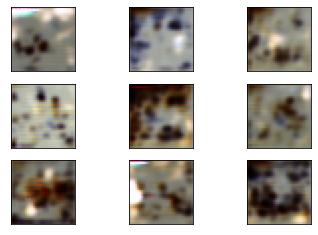

******************Epoch 32 Batch 0***************************
Real Discriminator loss: 0.5493605732917786
Fake Discriminator loss: 0.5709089040756226
Full Discriminator loss: 0.5601347386837006
Generator loss: 0.8741991519927979
******************Epoch 32 Batch 1***************************
Real Discriminator loss: 0.5714941024780273
Fake Discriminator loss: 0.5687437057495117
Full Discriminator loss: 0.5701189041137695
Generator loss: 0.9122612476348877
******************Epoch 32 Batch 2***************************
Real Discriminator loss: 0.5960158109664917
Fake Discriminator loss: 0.5461068153381348
Full Discriminator loss: 0.5710613131523132
Generator loss: 0.8883746266365051
******************Epoch 32 Batch 3***************************
Real Discriminator loss: 0.5359259843826294
Fake Discriminator loss: 0.5684042572975159
Full Discriminator loss: 0.5521651208400726
Generator loss: 0.8859236240386963
******************Epoch 32 Batch 4***************************
Real Discriminator los

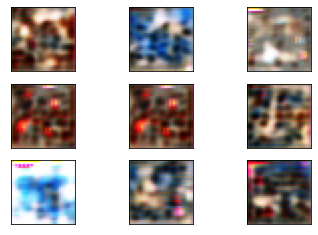

******************Epoch 33 Batch 0***************************
Real Discriminator loss: 0.6094058752059937
Fake Discriminator loss: 0.5312897562980652
Full Discriminator loss: 0.5703478157520294
Generator loss: 1.0405640602111816
******************Epoch 33 Batch 1***************************
Real Discriminator loss: 0.8234524726867676
Fake Discriminator loss: 0.5846865773200989
Full Discriminator loss: 0.7040695250034332
Generator loss: 1.0185847282409668
******************Epoch 33 Batch 2***************************
Real Discriminator loss: 0.7819079160690308
Fake Discriminator loss: 0.5905005931854248
Full Discriminator loss: 0.6862042546272278
Generator loss: 0.9371695518493652
******************Epoch 33 Batch 3***************************
Real Discriminator loss: 0.9171674251556396
Fake Discriminator loss: 0.5371410250663757
Full Discriminator loss: 0.7271542251110077
Generator loss: 0.9840519428253174
******************Epoch 33 Batch 4***************************
Real Discriminator los

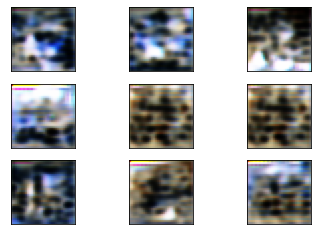

******************Epoch 34 Batch 0***************************
Real Discriminator loss: 0.690686821937561
Fake Discriminator loss: 0.7033743262290955
Full Discriminator loss: 0.6970305740833282
Generator loss: 0.7359623908996582
******************Epoch 34 Batch 1***************************
Real Discriminator loss: 0.6701866388320923
Fake Discriminator loss: 0.6848414540290833
Full Discriminator loss: 0.6775140464305878
Generator loss: 0.7129470109939575
******************Epoch 34 Batch 2***************************
Real Discriminator loss: 0.7062783241271973
Fake Discriminator loss: 0.7307684421539307
Full Discriminator loss: 0.718523383140564
Generator loss: 0.7271004319190979
******************Epoch 34 Batch 3***************************
Real Discriminator loss: 0.7086480855941772
Fake Discriminator loss: 0.6873555779457092
Full Discriminator loss: 0.6980018317699432
Generator loss: 0.7399883270263672
******************Epoch 34 Batch 4***************************
Real Discriminator loss:

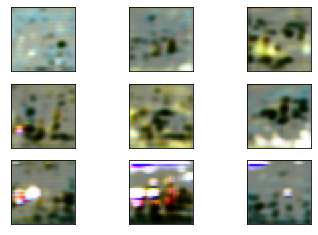

******************Epoch 35 Batch 0***************************
Real Discriminator loss: 0.5537655353546143
Fake Discriminator loss: 0.45523834228515625
Full Discriminator loss: 0.5045019388198853
Generator loss: 1.2436656951904297
******************Epoch 35 Batch 1***************************
Real Discriminator loss: 0.534778356552124
Fake Discriminator loss: 0.4951060116291046
Full Discriminator loss: 0.5149421840906143
Generator loss: 1.2564282417297363
******************Epoch 35 Batch 2***************************
Real Discriminator loss: 0.6371504664421082
Fake Discriminator loss: 0.47395655512809753
Full Discriminator loss: 0.5555535107851028
Generator loss: 1.23030424118042
******************Epoch 35 Batch 3***************************
Real Discriminator loss: 0.49289411306381226
Fake Discriminator loss: 0.4975314736366272
Full Discriminator loss: 0.4952127933502197
Generator loss: 1.1614997386932373
******************Epoch 35 Batch 4***************************
Real Discriminator los

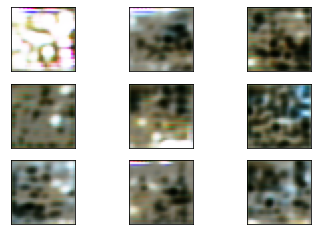

******************Epoch 36 Batch 0***************************
Real Discriminator loss: 0.5956116914749146
Fake Discriminator loss: 0.5743190050125122
Full Discriminator loss: 0.5849653482437134
Generator loss: 0.8682820796966553
******************Epoch 36 Batch 1***************************
Real Discriminator loss: 0.6637439727783203
Fake Discriminator loss: 0.6136802434921265
Full Discriminator loss: 0.6387121081352234
Generator loss: 0.9370352029800415
******************Epoch 36 Batch 2***************************
Real Discriminator loss: 0.6097157001495361
Fake Discriminator loss: 0.5791909694671631
Full Discriminator loss: 0.5944533348083496
Generator loss: 0.9279452562332153
******************Epoch 36 Batch 3***************************
Real Discriminator loss: 0.6185653209686279
Fake Discriminator loss: 0.588099479675293
Full Discriminator loss: 0.6033324003219604
Generator loss: 0.8613579869270325
******************Epoch 36 Batch 4***************************
Real Discriminator loss

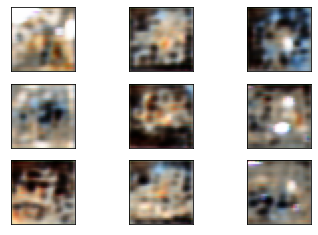

******************Epoch 37 Batch 0***************************
Real Discriminator loss: 0.6459047198295593
Fake Discriminator loss: 0.6712653040885925
Full Discriminator loss: 0.6585850119590759
Generator loss: 0.7221762537956238
******************Epoch 37 Batch 1***************************
Real Discriminator loss: 0.6250883936882019
Fake Discriminator loss: 0.6574515104293823
Full Discriminator loss: 0.6412699520587921
Generator loss: 0.7295894026756287
******************Epoch 37 Batch 2***************************
Real Discriminator loss: 0.6203182935714722
Fake Discriminator loss: 0.6757388114929199
Full Discriminator loss: 0.648028552532196
Generator loss: 0.753351092338562
******************Epoch 37 Batch 3***************************
Real Discriminator loss: 0.6315505504608154
Fake Discriminator loss: 0.6966948509216309
Full Discriminator loss: 0.6641227006912231
Generator loss: 0.7265650629997253
******************Epoch 37 Batch 4***************************
Real Discriminator loss:

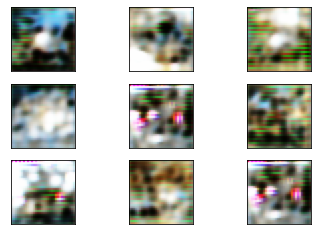

******************Epoch 38 Batch 0***************************
Real Discriminator loss: 0.7018858194351196
Fake Discriminator loss: 0.6301153898239136
Full Discriminator loss: 0.6660006046295166
Generator loss: 0.8404644131660461
******************Epoch 38 Batch 1***************************
Real Discriminator loss: 0.744915783405304
Fake Discriminator loss: 0.6706084609031677
Full Discriminator loss: 0.7077621221542358
Generator loss: 0.8541297316551208
******************Epoch 38 Batch 2***************************
Real Discriminator loss: 0.7076177597045898
Fake Discriminator loss: 0.6614872217178345
Full Discriminator loss: 0.6845524907112122
Generator loss: 0.8342310190200806
******************Epoch 38 Batch 3***************************
Real Discriminator loss: 0.7257532477378845
Fake Discriminator loss: 0.6248013973236084
Full Discriminator loss: 0.6752773225307465
Generator loss: 0.8724600076675415
******************Epoch 38 Batch 4***************************
Real Discriminator loss

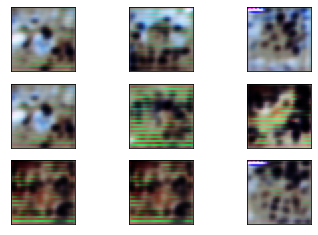

******************Epoch 39 Batch 0***************************
Real Discriminator loss: 0.5902480483055115
Fake Discriminator loss: 0.7383340001106262
Full Discriminator loss: 0.6642910242080688
Generator loss: 0.652461051940918
******************Epoch 39 Batch 1***************************
Real Discriminator loss: 0.5866318345069885
Fake Discriminator loss: 0.7651853561401367
Full Discriminator loss: 0.6759085953235626
Generator loss: 0.6745579242706299
******************Epoch 39 Batch 2***************************
Real Discriminator loss: 0.5743513703346252
Fake Discriminator loss: 0.7424952983856201
Full Discriminator loss: 0.6584233343601227
Generator loss: 0.7039833068847656
******************Epoch 39 Batch 3***************************
Real Discriminator loss: 0.5796207189559937
Fake Discriminator loss: 0.7360767722129822
Full Discriminator loss: 0.6578487455844879
Generator loss: 0.6522195935249329
******************Epoch 39 Batch 4***************************
Real Discriminator loss

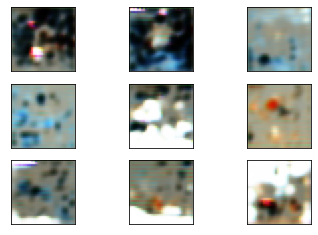

******************Epoch 40 Batch 0***************************
Real Discriminator loss: 0.7543867826461792
Fake Discriminator loss: 0.5725440979003906
Full Discriminator loss: 0.6634654402732849
Generator loss: 0.8292193412780762
******************Epoch 40 Batch 1***************************
Real Discriminator loss: 0.7138490676879883
Fake Discriminator loss: 0.6079170107841492
Full Discriminator loss: 0.6608830392360687
Generator loss: 0.8428254723548889
******************Epoch 40 Batch 2***************************
Real Discriminator loss: 0.7338491678237915
Fake Discriminator loss: 0.596709132194519
Full Discriminator loss: 0.6652791500091553
Generator loss: 0.8369266390800476
******************Epoch 40 Batch 3***************************
Real Discriminator loss: 0.7840903401374817
Fake Discriminator loss: 0.5900700092315674
Full Discriminator loss: 0.6870801746845245
Generator loss: 0.8604919910430908
******************Epoch 40 Batch 4***************************
Real Discriminator loss

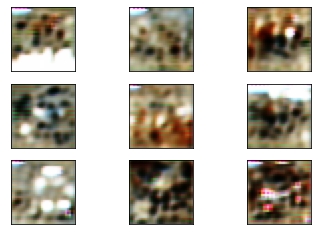

******************Epoch 41 Batch 0***************************
Real Discriminator loss: 0.6863539218902588
Fake Discriminator loss: 0.6871018409729004
Full Discriminator loss: 0.6867278814315796
Generator loss: 0.7372702956199646
******************Epoch 41 Batch 1***************************
Real Discriminator loss: 0.6886192560195923
Fake Discriminator loss: 0.736452043056488
Full Discriminator loss: 0.7125356495380402
Generator loss: 0.7111670970916748
******************Epoch 41 Batch 2***************************
Real Discriminator loss: 0.7233306765556335
Fake Discriminator loss: 0.6670795679092407
Full Discriminator loss: 0.6952051222324371
Generator loss: 0.8044016361236572
******************Epoch 41 Batch 3***************************
Real Discriminator loss: 0.7421057224273682
Fake Discriminator loss: 0.6463075280189514
Full Discriminator loss: 0.6942066252231598
Generator loss: 0.8308399319648743
******************Epoch 41 Batch 4***************************
Real Discriminator loss

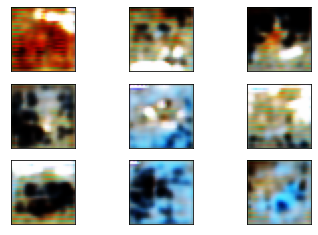

******************Epoch 42 Batch 0***************************
Real Discriminator loss: 0.5556547045707703
Fake Discriminator loss: 0.6756693720817566
Full Discriminator loss: 0.6156620383262634
Generator loss: 0.785223662853241
******************Epoch 42 Batch 1***************************
Real Discriminator loss: 0.5430163145065308
Fake Discriminator loss: 0.6785802841186523
Full Discriminator loss: 0.6107982993125916
Generator loss: 0.7634685635566711
******************Epoch 42 Batch 2***************************
Real Discriminator loss: 0.5361812710762024
Fake Discriminator loss: 0.7296693325042725
Full Discriminator loss: 0.6329253017902374
Generator loss: 0.7428064346313477
******************Epoch 42 Batch 3***************************
Real Discriminator loss: 0.4978240132331848
Fake Discriminator loss: 0.7173940539360046
Full Discriminator loss: 0.6076090335845947
Generator loss: 0.7771393060684204
******************Epoch 42 Batch 4***************************
Real Discriminator loss

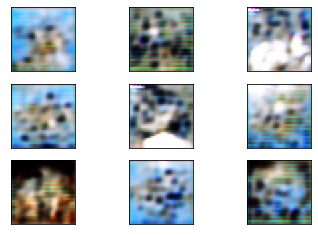

******************Epoch 43 Batch 0***************************
Real Discriminator loss: 0.7474707365036011
Fake Discriminator loss: 0.5987417101860046
Full Discriminator loss: 0.6731062233448029
Generator loss: 0.8135231733322144
******************Epoch 43 Batch 1***************************
Real Discriminator loss: 0.7813900709152222
Fake Discriminator loss: 0.59090656042099
Full Discriminator loss: 0.6861483156681061
Generator loss: 0.7955663204193115
******************Epoch 43 Batch 2***************************
Real Discriminator loss: 0.7864868640899658
Fake Discriminator loss: 0.6213672161102295
Full Discriminator loss: 0.7039270401000977
Generator loss: 0.7877081632614136
******************Epoch 43 Batch 3***************************
Real Discriminator loss: 0.7531164288520813
Fake Discriminator loss: 0.6081365346908569
Full Discriminator loss: 0.6806264817714691
Generator loss: 0.8111474514007568
******************Epoch 43 Batch 4***************************
Real Discriminator loss:

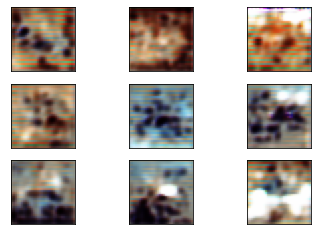

******************Epoch 44 Batch 0***************************
Real Discriminator loss: 0.6522235870361328
Fake Discriminator loss: 0.524607241153717
Full Discriminator loss: 0.5884154140949249
Generator loss: 1.0176399946212769
******************Epoch 44 Batch 1***************************
Real Discriminator loss: 0.5632168054580688
Fake Discriminator loss: 0.5533735156059265
Full Discriminator loss: 0.5582951605319977
Generator loss: 0.9955018758773804
******************Epoch 44 Batch 2***************************
Real Discriminator loss: 0.6031789779663086
Fake Discriminator loss: 0.631371796131134
Full Discriminator loss: 0.6172753870487213
Generator loss: 0.9091793894767761
******************Epoch 44 Batch 3***************************
Real Discriminator loss: 0.6306374073028564
Fake Discriminator loss: 0.6508679389953613
Full Discriminator loss: 0.6407526731491089
Generator loss: 0.881158173084259
******************Epoch 44 Batch 4***************************
Real Discriminator loss: 

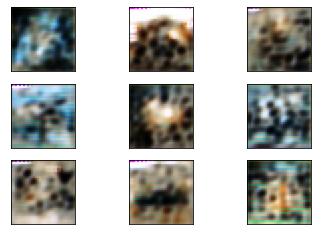

******************Epoch 45 Batch 0***************************
Real Discriminator loss: 0.8257861733436584
Fake Discriminator loss: 0.6141524314880371
Full Discriminator loss: 0.7199693024158478
Generator loss: 0.8175169229507446
******************Epoch 45 Batch 1***************************
Real Discriminator loss: 0.8345434069633484
Fake Discriminator loss: 0.6081528663635254
Full Discriminator loss: 0.7213481366634369
Generator loss: 0.8437116146087646
******************Epoch 45 Batch 2***************************
Real Discriminator loss: 0.8212792873382568
Fake Discriminator loss: 0.599277675151825
Full Discriminator loss: 0.7102784812450409
Generator loss: 0.8482272624969482
******************Epoch 45 Batch 3***************************
Real Discriminator loss: 0.8266352415084839
Fake Discriminator loss: 0.5843801498413086
Full Discriminator loss: 0.7055076956748962
Generator loss: 0.8223657608032227
******************Epoch 45 Batch 4***************************
Real Discriminator loss

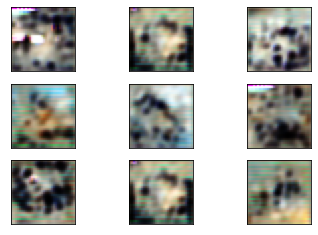

******************Epoch 46 Batch 0***************************
Real Discriminator loss: 0.7284903526306152
Fake Discriminator loss: 0.5992637276649475
Full Discriminator loss: 0.6638770401477814
Generator loss: 0.8042609691619873
******************Epoch 46 Batch 1***************************
Real Discriminator loss: 0.710460901260376
Fake Discriminator loss: 0.6476528644561768
Full Discriminator loss: 0.6790568828582764
Generator loss: 0.7801558971405029
******************Epoch 46 Batch 2***************************
Real Discriminator loss: 0.6822980642318726
Fake Discriminator loss: 0.6398350596427917
Full Discriminator loss: 0.6610665619373322
Generator loss: 0.7841851711273193
******************Epoch 46 Batch 3***************************
Real Discriminator loss: 0.6795055866241455
Fake Discriminator loss: 0.6303991675376892
Full Discriminator loss: 0.6549523770809174
Generator loss: 0.740225076675415
******************Epoch 46 Batch 4***************************
Real Discriminator loss:

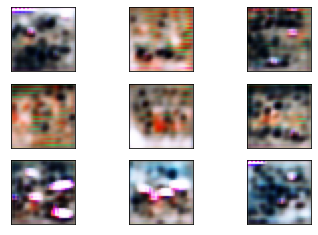

******************Epoch 47 Batch 0***************************
Real Discriminator loss: 0.7476383447647095
Fake Discriminator loss: 0.6749351024627686
Full Discriminator loss: 0.711286723613739
Generator loss: 0.8230582475662231
******************Epoch 47 Batch 1***************************
Real Discriminator loss: 0.7038512229919434
Fake Discriminator loss: 0.6555914878845215
Full Discriminator loss: 0.6797213554382324
Generator loss: 0.8251491785049438
******************Epoch 47 Batch 2***************************
Real Discriminator loss: 0.7194749116897583
Fake Discriminator loss: 0.6404367685317993
Full Discriminator loss: 0.6799558401107788
Generator loss: 0.7733302712440491
******************Epoch 47 Batch 3***************************
Real Discriminator loss: 0.6755309104919434
Fake Discriminator loss: 0.6655945181846619
Full Discriminator loss: 0.6705627143383026
Generator loss: 0.7686793804168701
******************Epoch 47 Batch 4***************************
Real Discriminator loss

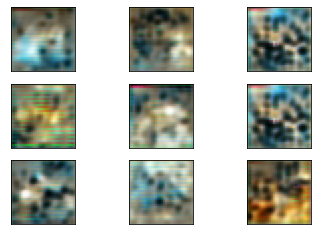

******************Epoch 48 Batch 0***************************
Real Discriminator loss: 0.7887135148048401
Fake Discriminator loss: 0.6156789064407349
Full Discriminator loss: 0.7021962106227875
Generator loss: 0.8112943172454834
******************Epoch 48 Batch 1***************************
Real Discriminator loss: 0.8035218715667725
Fake Discriminator loss: 0.5909672975540161
Full Discriminator loss: 0.6972445845603943
Generator loss: 0.8147963285446167
******************Epoch 48 Batch 2***************************
Real Discriminator loss: 0.8122830390930176
Fake Discriminator loss: 0.6283583641052246
Full Discriminator loss: 0.7203207015991211
Generator loss: 0.8154109716415405
******************Epoch 48 Batch 3***************************
Real Discriminator loss: 0.7971315979957581
Fake Discriminator loss: 0.6343498229980469
Full Discriminator loss: 0.7157407104969025
Generator loss: 0.8126400113105774
******************Epoch 48 Batch 4***************************
Real Discriminator los

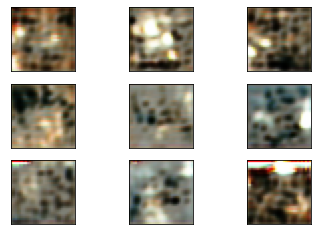

******************Epoch 49 Batch 0***************************
Real Discriminator loss: 0.7196955680847168
Fake Discriminator loss: 0.5899101495742798
Full Discriminator loss: 0.6548028588294983
Generator loss: 0.986289381980896
******************Epoch 49 Batch 1***************************
Real Discriminator loss: 0.707249641418457
Fake Discriminator loss: 0.5020360946655273
Full Discriminator loss: 0.6046428680419922
Generator loss: 0.9802006483078003
******************Epoch 49 Batch 2***************************
Real Discriminator loss: 0.6665375828742981
Fake Discriminator loss: 0.5027570724487305
Full Discriminator loss: 0.5846473276615143
Generator loss: 0.9254149198532104
******************Epoch 49 Batch 3***************************
Real Discriminator loss: 0.6787335276603699
Fake Discriminator loss: 0.5846587419509888
Full Discriminator loss: 0.6316961348056793
Generator loss: 0.9699552655220032
******************Epoch 49 Batch 4***************************
Real Discriminator loss:

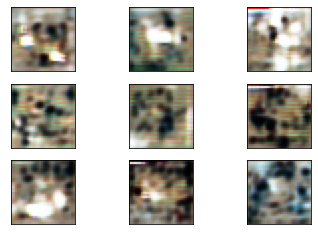

******************Epoch 50 Batch 0***************************
Real Discriminator loss: 0.7095541954040527
Fake Discriminator loss: 0.6590573191642761
Full Discriminator loss: 0.6843057572841644
Generator loss: 0.7855610847473145
******************Epoch 50 Batch 1***************************
Real Discriminator loss: 0.6789125204086304
Fake Discriminator loss: 0.6371082067489624
Full Discriminator loss: 0.6580103635787964
Generator loss: 0.7838428020477295
******************Epoch 50 Batch 2***************************
Real Discriminator loss: 0.6717692613601685
Fake Discriminator loss: 0.6541602611541748
Full Discriminator loss: 0.6629647612571716
Generator loss: 0.7881900072097778
******************Epoch 50 Batch 3***************************
Real Discriminator loss: 0.7013791799545288
Fake Discriminator loss: 0.6488324999809265
Full Discriminator loss: 0.6751058399677277
Generator loss: 0.7575228214263916
******************Epoch 50 Batch 4***************************
Real Discriminator los

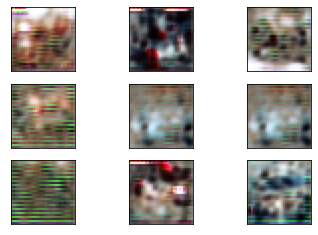

******************Epoch 51 Batch 0***************************
Real Discriminator loss: 0.5576847195625305
Fake Discriminator loss: 0.5894383788108826
Full Discriminator loss: 0.5735615491867065
Generator loss: 0.9199649095535278
******************Epoch 51 Batch 1***************************
Real Discriminator loss: 0.5785458087921143
Fake Discriminator loss: 0.6309398412704468
Full Discriminator loss: 0.6047428250312805
Generator loss: 0.8221712112426758
******************Epoch 51 Batch 2***************************
Real Discriminator loss: 0.5635099411010742
Fake Discriminator loss: 0.6328556537628174
Full Discriminator loss: 0.5981827974319458
Generator loss: 0.8824469447135925
******************Epoch 51 Batch 3***************************
Real Discriminator loss: 0.5193999409675598
Fake Discriminator loss: 0.7050290107727051
Full Discriminator loss: 0.6122144758701324
Generator loss: 0.7820550799369812
******************Epoch 51 Batch 4***************************
Real Discriminator los

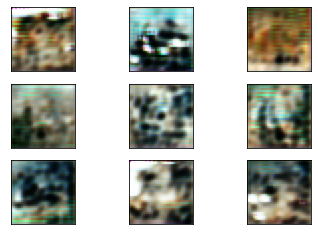

******************Epoch 52 Batch 0***************************
Real Discriminator loss: 0.653632402420044
Fake Discriminator loss: 0.699601411819458
Full Discriminator loss: 0.676616907119751
Generator loss: 0.691907525062561
******************Epoch 52 Batch 1***************************
Real Discriminator loss: 0.648117184638977
Fake Discriminator loss: 0.7196357250213623
Full Discriminator loss: 0.6838764548301697
Generator loss: 0.6910973191261292
******************Epoch 52 Batch 2***************************
Real Discriminator loss: 0.6320034861564636
Fake Discriminator loss: 0.7153457403182983
Full Discriminator loss: 0.673674613237381
Generator loss: 0.687978208065033
******************Epoch 52 Batch 3***************************
Real Discriminator loss: 0.6453633904457092
Fake Discriminator loss: 0.69582200050354
Full Discriminator loss: 0.6705926954746246
Generator loss: 0.6862570643424988
******************Epoch 52 Batch 4***************************
Real Discriminator loss: 0.6573

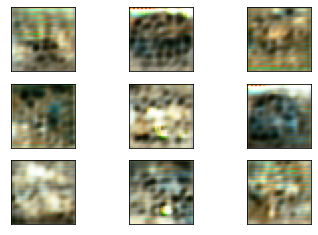

******************Epoch 53 Batch 0***************************
Real Discriminator loss: 0.6610924005508423
Fake Discriminator loss: 0.6397361755371094
Full Discriminator loss: 0.6504142880439758
Generator loss: 0.7671818137168884
******************Epoch 53 Batch 1***************************
Real Discriminator loss: 0.639306366443634
Fake Discriminator loss: 0.6805442571640015
Full Discriminator loss: 0.6599253118038177
Generator loss: 0.7830437421798706
******************Epoch 53 Batch 2***************************
Real Discriminator loss: 0.6253912448883057
Fake Discriminator loss: 0.655653178691864
Full Discriminator loss: 0.6405222117900848
Generator loss: 0.7792683839797974
******************Epoch 53 Batch 3***************************
Real Discriminator loss: 0.6428369283676147
Fake Discriminator loss: 0.6501251459121704
Full Discriminator loss: 0.6464810371398926
Generator loss: 0.7840737104415894
******************Epoch 53 Batch 4***************************
Real Discriminator loss:

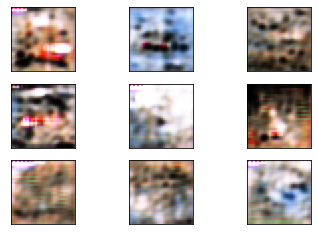

******************Epoch 54 Batch 0***************************
Real Discriminator loss: 0.7088015079498291
Fake Discriminator loss: 0.6174574494361877
Full Discriminator loss: 0.6631294786930084
Generator loss: 0.7805171608924866
******************Epoch 54 Batch 1***************************
Real Discriminator loss: 0.7090325355529785
Fake Discriminator loss: 0.6165863275527954
Full Discriminator loss: 0.662809431552887
Generator loss: 0.7602924704551697
******************Epoch 54 Batch 2***************************
Real Discriminator loss: 0.7098363637924194
Fake Discriminator loss: 0.6466881632804871
Full Discriminator loss: 0.6782622635364532
Generator loss: 0.7803518176078796
******************Epoch 54 Batch 3***************************
Real Discriminator loss: 0.7076905965805054
Fake Discriminator loss: 0.629097044467926
Full Discriminator loss: 0.6683938205242157
Generator loss: 0.7559735774993896
******************Epoch 54 Batch 4***************************
Real Discriminator loss:

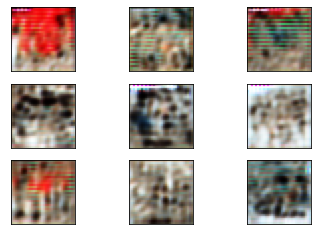

******************Epoch 55 Batch 0***************************
Real Discriminator loss: 0.6781481504440308
Fake Discriminator loss: 0.6714171767234802
Full Discriminator loss: 0.6747826635837555
Generator loss: 0.7736643552780151
******************Epoch 55 Batch 1***************************
Real Discriminator loss: 0.7017398476600647
Fake Discriminator loss: 0.6540927886962891
Full Discriminator loss: 0.6779163181781769
Generator loss: 0.7545448541641235
******************Epoch 55 Batch 2***************************
Real Discriminator loss: 0.6846029758453369
Fake Discriminator loss: 0.6402183175086975
Full Discriminator loss: 0.6624106466770172
Generator loss: 0.7402870655059814
******************Epoch 55 Batch 3***************************
Real Discriminator loss: 0.6716563701629639
Fake Discriminator loss: 0.6439089179039001
Full Discriminator loss: 0.657782644033432
Generator loss: 0.7418513298034668
******************Epoch 55 Batch 4***************************
Real Discriminator loss

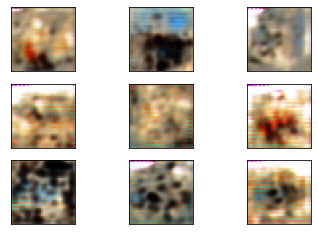

******************Epoch 56 Batch 0***************************
Real Discriminator loss: 0.6470398902893066
Fake Discriminator loss: 0.642236590385437
Full Discriminator loss: 0.6446382403373718
Generator loss: 0.8609089851379395
******************Epoch 56 Batch 1***************************
Real Discriminator loss: 0.6261502504348755
Fake Discriminator loss: 0.7065874338150024
Full Discriminator loss: 0.666368842124939
Generator loss: 0.8715478181838989
******************Epoch 56 Batch 2***************************
Real Discriminator loss: 0.6294186115264893
Fake Discriminator loss: 0.6078097820281982
Full Discriminator loss: 0.6186141967773438
Generator loss: 0.879526674747467
******************Epoch 56 Batch 3***************************
Real Discriminator loss: 0.6718751192092896
Fake Discriminator loss: 0.5927132368087769
Full Discriminator loss: 0.6322941780090332
Generator loss: 0.8481165170669556
******************Epoch 56 Batch 4***************************
Real Discriminator loss: 

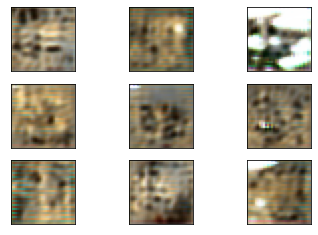

******************Epoch 57 Batch 0***************************
Real Discriminator loss: 0.5813337564468384
Fake Discriminator loss: 0.68994140625
Full Discriminator loss: 0.6356375813484192
Generator loss: 0.7079508304595947
******************Epoch 57 Batch 1***************************
Real Discriminator loss: 0.5858692526817322
Fake Discriminator loss: 0.678595781326294
Full Discriminator loss: 0.6322325170040131
Generator loss: 0.6899416446685791
******************Epoch 57 Batch 2***************************
Real Discriminator loss: 0.5751907229423523
Fake Discriminator loss: 0.6835673451423645
Full Discriminator loss: 0.6293790340423584
Generator loss: 0.6987102627754211
******************Epoch 57 Batch 3***************************
Real Discriminator loss: 0.542952299118042
Fake Discriminator loss: 0.6984782814979553
Full Discriminator loss: 0.6207152903079987
Generator loss: 0.6992089152336121
******************Epoch 57 Batch 4***************************
Real Discriminator loss: 0.54

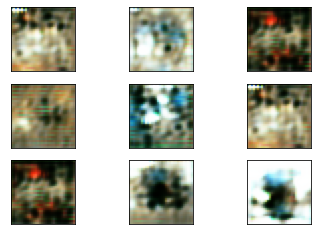

******************Epoch 58 Batch 0***************************
Real Discriminator loss: 0.7397415041923523
Fake Discriminator loss: 0.587268590927124
Full Discriminator loss: 0.6635050475597382
Generator loss: 0.8711115717887878
******************Epoch 58 Batch 1***************************
Real Discriminator loss: 0.7709097862243652
Fake Discriminator loss: 0.5694385170936584
Full Discriminator loss: 0.6701741516590118
Generator loss: 0.8924627304077148
******************Epoch 58 Batch 2***************************
Real Discriminator loss: 0.7837367057800293
Fake Discriminator loss: 0.6037275791168213
Full Discriminator loss: 0.6937321424484253
Generator loss: 0.8548847436904907
******************Epoch 58 Batch 3***************************
Real Discriminator loss: 0.7690809965133667
Fake Discriminator loss: 0.5876845121383667
Full Discriminator loss: 0.6783827543258667
Generator loss: 0.8262083530426025
******************Epoch 58 Batch 4***************************
Real Discriminator loss

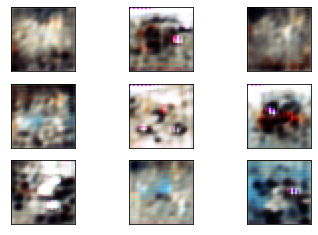

******************Epoch 59 Batch 0***************************
Real Discriminator loss: 0.7506347894668579
Fake Discriminator loss: 0.6193193197250366
Full Discriminator loss: 0.6849770545959473
Generator loss: 0.7947959899902344
******************Epoch 59 Batch 1***************************
Real Discriminator loss: 0.7251930236816406
Fake Discriminator loss: 0.6750307679176331
Full Discriminator loss: 0.7001118957996368
Generator loss: 0.7598392963409424
******************Epoch 59 Batch 2***************************
Real Discriminator loss: 0.6947727203369141
Fake Discriminator loss: 0.6396474838256836
Full Discriminator loss: 0.6672101020812988
Generator loss: 0.7934048175811768
******************Epoch 59 Batch 3***************************
Real Discriminator loss: 0.7256348729133606
Fake Discriminator loss: 0.6449841856956482
Full Discriminator loss: 0.6853095293045044
Generator loss: 0.7898950576782227
******************Epoch 59 Batch 4***************************
Real Discriminator los

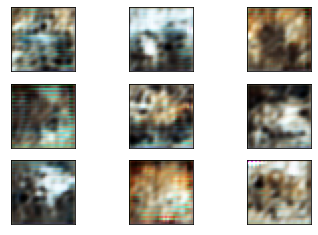

******************Epoch 60 Batch 0***************************
Real Discriminator loss: 0.6941629648208618
Fake Discriminator loss: 0.6606566309928894
Full Discriminator loss: 0.6774097979068756
Generator loss: 0.7847199440002441
******************Epoch 60 Batch 1***************************
Real Discriminator loss: 0.6952488422393799
Fake Discriminator loss: 0.6138993501663208
Full Discriminator loss: 0.6545740962028503
Generator loss: 0.7944526672363281
******************Epoch 60 Batch 2***************************
Real Discriminator loss: 0.6753029823303223
Fake Discriminator loss: 0.6232324838638306
Full Discriminator loss: 0.6492677330970764
Generator loss: 0.7772918939590454
******************Epoch 60 Batch 3***************************
Real Discriminator loss: 0.7009567618370056
Fake Discriminator loss: 0.6647083163261414
Full Discriminator loss: 0.6828325390815735
Generator loss: 0.784333348274231
******************Epoch 60 Batch 4***************************
Real Discriminator loss

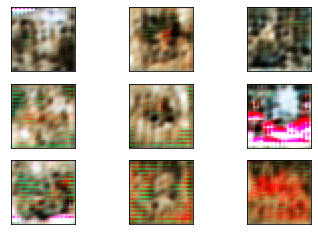

******************Epoch 61 Batch 0***************************
Real Discriminator loss: 0.6315554976463318
Fake Discriminator loss: 0.6807360649108887
Full Discriminator loss: 0.6561457812786102
Generator loss: 0.7599309086799622
******************Epoch 61 Batch 1***************************
Real Discriminator loss: 0.6595177054405212
Fake Discriminator loss: 0.6599475741386414
Full Discriminator loss: 0.6597326397895813
Generator loss: 0.7686732411384583
******************Epoch 61 Batch 2***************************
Real Discriminator loss: 0.6417101621627808
Fake Discriminator loss: 0.6787132024765015
Full Discriminator loss: 0.6602116823196411
Generator loss: 0.7603977918624878
******************Epoch 61 Batch 3***************************
Real Discriminator loss: 0.6291342377662659
Fake Discriminator loss: 0.7108538150787354
Full Discriminator loss: 0.6699940264225006
Generator loss: 0.7569838166236877
******************Epoch 61 Batch 4***************************
Real Discriminator los

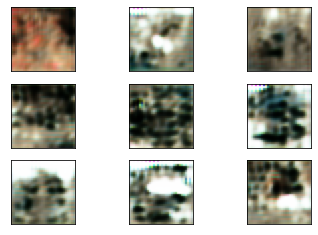

******************Epoch 62 Batch 0***************************
Real Discriminator loss: 0.6850937604904175
Fake Discriminator loss: 0.6852915287017822
Full Discriminator loss: 0.6851926445960999
Generator loss: 0.7261425852775574
******************Epoch 62 Batch 1***************************
Real Discriminator loss: 0.6645376682281494
Fake Discriminator loss: 0.7073507308959961
Full Discriminator loss: 0.6859441995620728
Generator loss: 0.6972150206565857
******************Epoch 62 Batch 2***************************
Real Discriminator loss: 0.650708019733429
Fake Discriminator loss: 0.7031530141830444
Full Discriminator loss: 0.6769305169582367
Generator loss: 0.7110118269920349
******************Epoch 62 Batch 3***************************
Real Discriminator loss: 0.5917073488235474
Fake Discriminator loss: 0.6725000143051147
Full Discriminator loss: 0.632103681564331
Generator loss: 0.7064893841743469
******************Epoch 62 Batch 4***************************
Real Discriminator loss:

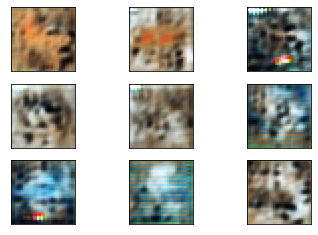

******************Epoch 63 Batch 0***************************
Real Discriminator loss: 0.6847174763679504
Fake Discriminator loss: 0.7017382979393005
Full Discriminator loss: 0.6932278871536255
Generator loss: 0.7485120296478271
******************Epoch 63 Batch 1***************************
Real Discriminator loss: 0.6892091035842896
Fake Discriminator loss: 0.6493600606918335
Full Discriminator loss: 0.6692845821380615
Generator loss: 0.753205418586731
******************Epoch 63 Batch 2***************************
Real Discriminator loss: 0.6838492155075073
Fake Discriminator loss: 0.6846269965171814
Full Discriminator loss: 0.6842381060123444
Generator loss: 0.7443668842315674
******************Epoch 63 Batch 3***************************
Real Discriminator loss: 0.6861631274223328
Fake Discriminator loss: 0.7006018757820129
Full Discriminator loss: 0.6933825016021729
Generator loss: 0.7436801791191101
******************Epoch 63 Batch 4***************************
Real Discriminator loss

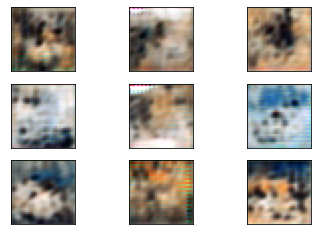

******************Epoch 64 Batch 0***************************
Real Discriminator loss: 0.6994129419326782
Fake Discriminator loss: 0.6369873881340027
Full Discriminator loss: 0.6682001650333405
Generator loss: 0.8856019973754883
******************Epoch 64 Batch 1***************************
Real Discriminator loss: 0.7531265020370483
Fake Discriminator loss: 0.6157070994377136
Full Discriminator loss: 0.684416800737381
Generator loss: 0.8418329358100891
******************Epoch 64 Batch 2***************************
Real Discriminator loss: 0.7271196842193604
Fake Discriminator loss: 0.666313886642456
Full Discriminator loss: 0.6967167854309082
Generator loss: 0.9026708602905273
******************Epoch 64 Batch 3***************************
Real Discriminator loss: 0.7281613349914551
Fake Discriminator loss: 0.6904484629631042
Full Discriminator loss: 0.7093048989772797
Generator loss: 0.880131185054779
******************Epoch 64 Batch 4***************************
Real Discriminator loss: 

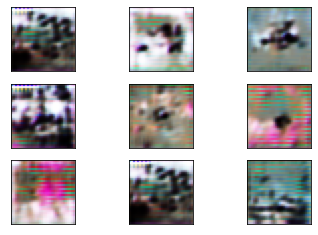

******************Epoch 65 Batch 0***************************
Real Discriminator loss: 0.6352379322052002
Fake Discriminator loss: 0.590429961681366
Full Discriminator loss: 0.6128339469432831
Generator loss: 0.8974558115005493
******************Epoch 65 Batch 1***************************
Real Discriminator loss: 0.7053142189979553
Fake Discriminator loss: 0.6220144033432007
Full Discriminator loss: 0.663664311170578
Generator loss: 0.9449248313903809
******************Epoch 65 Batch 2***************************
Real Discriminator loss: 0.656488299369812
Fake Discriminator loss: 0.5670337677001953
Full Discriminator loss: 0.6117610335350037
Generator loss: 0.928973376750946
******************Epoch 65 Batch 3***************************
Real Discriminator loss: 0.6969585418701172
Fake Discriminator loss: 0.6155635118484497
Full Discriminator loss: 0.6562610268592834
Generator loss: 0.9408659934997559
******************Epoch 65 Batch 4***************************
Real Discriminator loss: 0

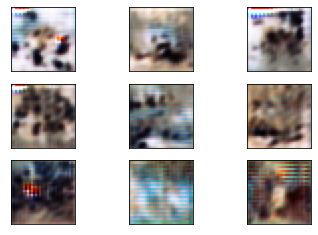

******************Epoch 66 Batch 0***************************
Real Discriminator loss: 0.7036749124526978
Fake Discriminator loss: 0.5660076141357422
Full Discriminator loss: 0.63484126329422
Generator loss: 0.9435071349143982
******************Epoch 66 Batch 1***************************
Real Discriminator loss: 0.6683767437934875
Fake Discriminator loss: 0.6182465553283691
Full Discriminator loss: 0.6433116495609283
Generator loss: 0.9100613594055176
******************Epoch 66 Batch 2***************************
Real Discriminator loss: 0.6899796724319458
Fake Discriminator loss: 0.6038082242012024
Full Discriminator loss: 0.6468939483165741
Generator loss: 0.9748392105102539
******************Epoch 66 Batch 3***************************
Real Discriminator loss: 0.6818180084228516
Fake Discriminator loss: 0.5613257884979248
Full Discriminator loss: 0.6215718984603882
Generator loss: 0.9570420384407043
******************Epoch 66 Batch 4***************************
Real Discriminator loss:

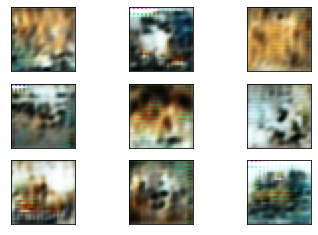

******************Epoch 67 Batch 0***************************
Real Discriminator loss: 0.5819441080093384
Fake Discriminator loss: 0.644477903842926
Full Discriminator loss: 0.6132110059261322
Generator loss: 0.7990223169326782
******************Epoch 67 Batch 1***************************
Real Discriminator loss: 0.5338470935821533
Fake Discriminator loss: 0.6843053698539734
Full Discriminator loss: 0.6090762317180634
Generator loss: 0.8680760264396667
******************Epoch 67 Batch 2***************************
Real Discriminator loss: 0.5543153882026672
Fake Discriminator loss: 0.6463382244110107
Full Discriminator loss: 0.600326806306839
Generator loss: 0.848119854927063
******************Epoch 67 Batch 3***************************
Real Discriminator loss: 0.48870187997817993
Fake Discriminator loss: 0.6367839574813843
Full Discriminator loss: 0.5627429187297821
Generator loss: 0.8894249200820923
******************Epoch 67 Batch 4***************************
Real Discriminator loss:

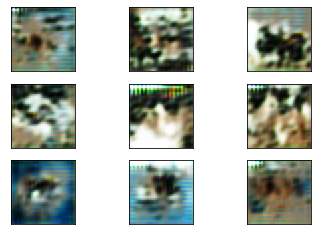

******************Epoch 68 Batch 0***************************
Real Discriminator loss: 0.6175453662872314
Fake Discriminator loss: 0.6272105574607849
Full Discriminator loss: 0.6223779618740082
Generator loss: 0.9169087409973145
******************Epoch 68 Batch 1***************************
Real Discriminator loss: 0.5266040563583374
Fake Discriminator loss: 0.656343936920166
Full Discriminator loss: 0.5914739966392517
Generator loss: 0.8716828227043152
******************Epoch 68 Batch 2***************************
Real Discriminator loss: 0.5846289992332458
Fake Discriminator loss: 0.675753653049469
Full Discriminator loss: 0.6301913261413574
Generator loss: 0.9262494444847107
******************Epoch 68 Batch 3***************************
Real Discriminator loss: 0.5487529039382935
Fake Discriminator loss: 0.6373392939567566
Full Discriminator loss: 0.593046098947525
Generator loss: 0.9227179288864136
******************Epoch 68 Batch 4***************************
Real Discriminator loss: 

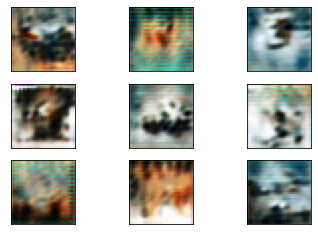

******************Epoch 69 Batch 0***************************
Real Discriminator loss: 0.7526949644088745
Fake Discriminator loss: 0.6531708240509033
Full Discriminator loss: 0.7029328942298889
Generator loss: 0.8485240936279297
******************Epoch 69 Batch 1***************************
Real Discriminator loss: 0.6763390302658081
Fake Discriminator loss: 0.7181751728057861
Full Discriminator loss: 0.6972571015357971
Generator loss: 0.8481273651123047
******************Epoch 69 Batch 2***************************
Real Discriminator loss: 0.6988879442214966
Fake Discriminator loss: 0.6937746405601501
Full Discriminator loss: 0.6963312923908234
Generator loss: 0.8729567527770996
******************Epoch 69 Batch 3***************************
Real Discriminator loss: 0.662139892578125
Fake Discriminator loss: 0.6995724439620972
Full Discriminator loss: 0.6808561682701111
Generator loss: 0.8219066262245178
******************Epoch 69 Batch 4***************************
Real Discriminator loss

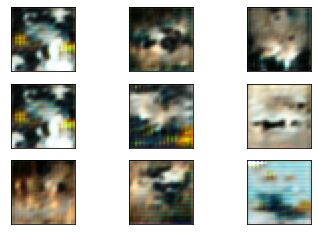

******************Epoch 70 Batch 0***************************
Real Discriminator loss: 0.6899632215499878
Fake Discriminator loss: 0.6073252558708191
Full Discriminator loss: 0.6486442387104034
Generator loss: 0.8585916757583618
******************Epoch 70 Batch 1***************************
Real Discriminator loss: 0.6885204911231995
Fake Discriminator loss: 0.7110202312469482
Full Discriminator loss: 0.6997703611850739
Generator loss: 0.8554795980453491
******************Epoch 70 Batch 2***************************
Real Discriminator loss: 0.6840271353721619
Fake Discriminator loss: 0.6636676788330078
Full Discriminator loss: 0.6738474071025848
Generator loss: 0.8986120820045471
******************Epoch 70 Batch 3***************************
Real Discriminator loss: 0.6718052625656128
Fake Discriminator loss: 0.591463565826416
Full Discriminator loss: 0.6316344141960144
Generator loss: 0.915254533290863
******************Epoch 70 Batch 4***************************
Real Discriminator loss:

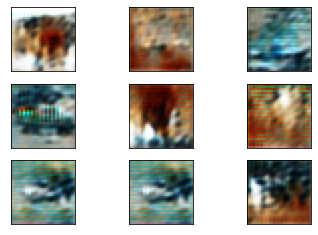

******************Epoch 71 Batch 0***************************
Real Discriminator loss: 0.6134814023971558
Fake Discriminator loss: 0.6877297163009644
Full Discriminator loss: 0.6506055593490601
Generator loss: 0.779371976852417
******************Epoch 71 Batch 1***************************
Real Discriminator loss: 0.6343567371368408
Fake Discriminator loss: 0.714914858341217
Full Discriminator loss: 0.6746357977390289
Generator loss: 0.8364324569702148
******************Epoch 71 Batch 2***************************
Real Discriminator loss: 0.6303571462631226
Fake Discriminator loss: 0.6373821496963501
Full Discriminator loss: 0.6338696479797363
Generator loss: 0.7923930287361145
******************Epoch 71 Batch 3***************************
Real Discriminator loss: 0.6025366187095642
Fake Discriminator loss: 0.6375131011009216
Full Discriminator loss: 0.6200248599052429
Generator loss: 0.7763732671737671
******************Epoch 71 Batch 4***************************
Real Discriminator loss:

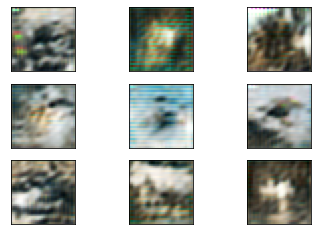

******************Epoch 72 Batch 0***************************
Real Discriminator loss: 0.5857808589935303
Fake Discriminator loss: 0.5844382643699646
Full Discriminator loss: 0.5851095616817474
Generator loss: 0.9132815599441528
******************Epoch 72 Batch 1***************************
Real Discriminator loss: 0.5483198165893555
Fake Discriminator loss: 0.6049835085868835
Full Discriminator loss: 0.5766516625881195
Generator loss: 0.9018696546554565
******************Epoch 72 Batch 2***************************
Real Discriminator loss: 0.5105571746826172
Fake Discriminator loss: 0.5579558610916138
Full Discriminator loss: 0.5342565178871155
Generator loss: 0.9249855875968933
******************Epoch 72 Batch 3***************************
Real Discriminator loss: 0.46877342462539673
Fake Discriminator loss: 0.7566461563110352
Full Discriminator loss: 0.6127097904682159
Generator loss: 0.9311307668685913
******************Epoch 72 Batch 4***************************
Real Discriminator lo

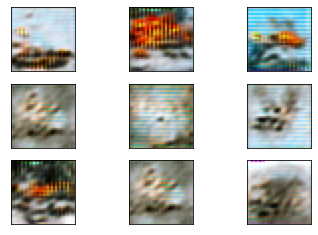

******************Epoch 73 Batch 0***************************
Real Discriminator loss: 0.7019461393356323
Fake Discriminator loss: 0.7004255056381226
Full Discriminator loss: 0.7011858224868774
Generator loss: 0.7688065767288208
******************Epoch 73 Batch 1***************************
Real Discriminator loss: 0.6092032194137573
Fake Discriminator loss: 0.6920831203460693
Full Discriminator loss: 0.6506431698799133
Generator loss: 0.7445418238639832
******************Epoch 73 Batch 2***************************
Real Discriminator loss: 0.5674849152565002
Fake Discriminator loss: 0.6987485885620117
Full Discriminator loss: 0.633116751909256
Generator loss: 0.7810481786727905
******************Epoch 73 Batch 3***************************
Real Discriminator loss: 0.580014169216156
Fake Discriminator loss: 0.6701247692108154
Full Discriminator loss: 0.6250694692134857
Generator loss: 0.8170231580734253
******************Epoch 73 Batch 4***************************
Real Discriminator loss:

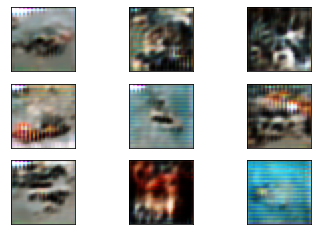

******************Epoch 74 Batch 0***************************
Real Discriminator loss: 0.6510511636734009
Fake Discriminator loss: 0.5816018581390381
Full Discriminator loss: 0.6163265109062195
Generator loss: 0.8638378977775574
******************Epoch 74 Batch 1***************************
Real Discriminator loss: 0.6007916927337646
Fake Discriminator loss: 0.5989927053451538
Full Discriminator loss: 0.5998921990394592
Generator loss: 0.8582489490509033
******************Epoch 74 Batch 2***************************
Real Discriminator loss: 0.6343729496002197
Fake Discriminator loss: 0.6233115196228027
Full Discriminator loss: 0.6288422346115112
Generator loss: 0.8650481700897217
******************Epoch 74 Batch 3***************************
Real Discriminator loss: 0.6343560218811035
Fake Discriminator loss: 0.5676887035369873
Full Discriminator loss: 0.6010223627090454
Generator loss: 0.8667880296707153
******************Epoch 74 Batch 4***************************
Real Discriminator los

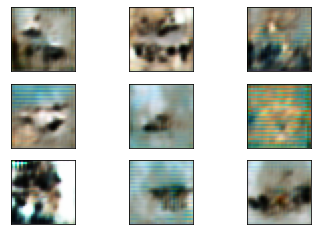

******************Epoch 75 Batch 0***************************
Real Discriminator loss: 0.6994366645812988
Fake Discriminator loss: 0.5943101048469543
Full Discriminator loss: 0.6468733847141266
Generator loss: 0.8362182974815369
******************Epoch 75 Batch 1***************************
Real Discriminator loss: 0.7247576713562012
Fake Discriminator loss: 0.6418816447257996
Full Discriminator loss: 0.6833196580410004
Generator loss: 0.847771406173706
******************Epoch 75 Batch 2***************************
Real Discriminator loss: 0.7091917991638184
Fake Discriminator loss: 0.643433690071106
Full Discriminator loss: 0.6763127446174622
Generator loss: 0.8175738453865051
******************Epoch 75 Batch 3***************************
Real Discriminator loss: 0.637621283531189
Fake Discriminator loss: 0.6163322329521179
Full Discriminator loss: 0.6269767582416534
Generator loss: 0.8838028907775879
******************Epoch 75 Batch 4***************************
Real Discriminator loss: 

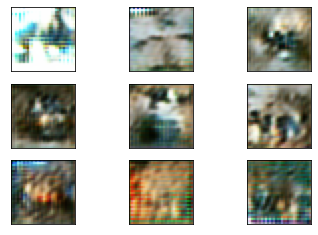

******************Epoch 76 Batch 0***************************
Real Discriminator loss: 0.6815879940986633
Fake Discriminator loss: 0.5741091966629028
Full Discriminator loss: 0.6278485953807831
Generator loss: 1.0173085927963257
******************Epoch 76 Batch 1***************************
Real Discriminator loss: 0.6665564775466919
Fake Discriminator loss: 0.550362229347229
Full Discriminator loss: 0.6084593534469604
Generator loss: 0.9842038154602051
******************Epoch 76 Batch 2***************************
Real Discriminator loss: 0.6750449538230896
Fake Discriminator loss: 0.6147899627685547
Full Discriminator loss: 0.6449174582958221
Generator loss: 0.8675731420516968
******************Epoch 76 Batch 3***************************
Real Discriminator loss: 0.6360598206520081
Fake Discriminator loss: 0.5455597639083862
Full Discriminator loss: 0.5908097922801971
Generator loss: 0.9042782783508301
******************Epoch 76 Batch 4***************************
Real Discriminator loss

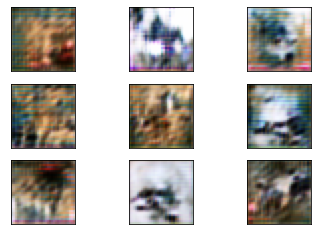

******************Epoch 77 Batch 0***************************
Real Discriminator loss: 0.6994330883026123
Fake Discriminator loss: 0.6877965927124023
Full Discriminator loss: 0.6936148405075073
Generator loss: 0.864829421043396
******************Epoch 77 Batch 1***************************
Real Discriminator loss: 0.7363799810409546
Fake Discriminator loss: 0.6351036429405212
Full Discriminator loss: 0.6857418119907379
Generator loss: 0.8134112358093262
******************Epoch 77 Batch 2***************************
Real Discriminator loss: 0.6750961542129517
Fake Discriminator loss: 0.6633214950561523
Full Discriminator loss: 0.669208824634552
Generator loss: 0.8976686000823975
******************Epoch 77 Batch 3***************************
Real Discriminator loss: 0.6672834157943726
Fake Discriminator loss: 0.6364573240280151
Full Discriminator loss: 0.6518703699111938
Generator loss: 0.845553994178772
******************Epoch 77 Batch 4***************************
Real Discriminator loss: 

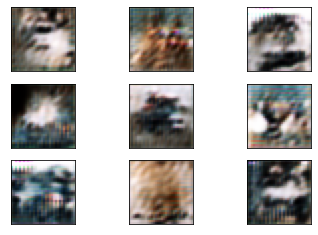

******************Epoch 78 Batch 0***************************
Real Discriminator loss: 0.6571741700172424
Fake Discriminator loss: 0.6278276443481445
Full Discriminator loss: 0.6425009071826935
Generator loss: 0.8524578213691711
******************Epoch 78 Batch 1***************************
Real Discriminator loss: 0.6500195264816284
Fake Discriminator loss: 0.6190219521522522
Full Discriminator loss: 0.6345207393169403
Generator loss: 0.8382748365402222
******************Epoch 78 Batch 2***************************
Real Discriminator loss: 0.6798625588417053
Fake Discriminator loss: 0.6430585980415344
Full Discriminator loss: 0.6614605784416199
Generator loss: 0.8382240533828735
******************Epoch 78 Batch 3***************************
Real Discriminator loss: 0.6314331889152527
Fake Discriminator loss: 0.6032593846321106
Full Discriminator loss: 0.6173462867736816
Generator loss: 0.8605995178222656
******************Epoch 78 Batch 4***************************
Real Discriminator los

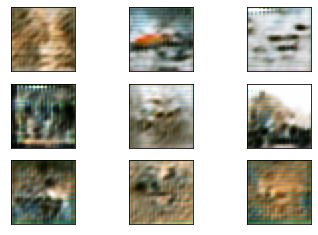

******************Epoch 79 Batch 0***************************
Real Discriminator loss: 0.591380774974823
Fake Discriminator loss: 0.6928318738937378
Full Discriminator loss: 0.6421063244342804
Generator loss: 0.8305748105049133
******************Epoch 79 Batch 1***************************
Real Discriminator loss: 0.6101399660110474
Fake Discriminator loss: 0.6810628175735474
Full Discriminator loss: 0.6456013917922974
Generator loss: 0.8145550489425659
******************Epoch 79 Batch 2***************************
Real Discriminator loss: 0.5990273952484131
Fake Discriminator loss: 0.6726216673851013
Full Discriminator loss: 0.6358245313167572
Generator loss: 0.824449896812439
******************Epoch 79 Batch 3***************************
Real Discriminator loss: 0.5627058744430542
Fake Discriminator loss: 0.6803258657455444
Full Discriminator loss: 0.6215158700942993
Generator loss: 0.8292700052261353
******************Epoch 79 Batch 4***************************
Real Discriminator loss:

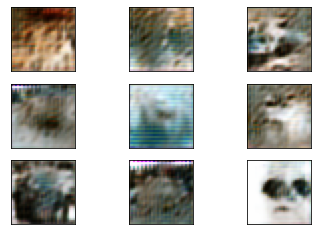

******************Epoch 80 Batch 0***************************
Real Discriminator loss: 0.6666911244392395
Fake Discriminator loss: 0.5638405084609985
Full Discriminator loss: 0.615265816450119
Generator loss: 0.8976439237594604
******************Epoch 80 Batch 1***************************
Real Discriminator loss: 0.6758379936218262
Fake Discriminator loss: 0.5907056331634521
Full Discriminator loss: 0.6332718133926392
Generator loss: 0.8526768088340759
******************Epoch 80 Batch 2***************************
Real Discriminator loss: 0.606715977191925
Fake Discriminator loss: 0.6200719475746155
Full Discriminator loss: 0.6133939623832703
Generator loss: 0.8247618675231934
******************Epoch 80 Batch 3***************************
Real Discriminator loss: 0.6245400309562683
Fake Discriminator loss: 0.6434302926063538
Full Discriminator loss: 0.633985161781311
Generator loss: 0.7611926198005676
******************Epoch 80 Batch 4***************************
Real Discriminator loss: 

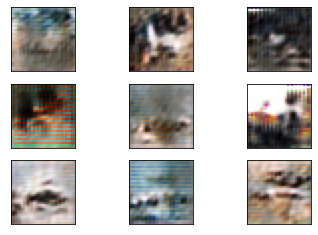

******************Epoch 81 Batch 0***************************
Real Discriminator loss: 0.4898558259010315
Fake Discriminator loss: 0.6223260164260864
Full Discriminator loss: 0.556090921163559
Generator loss: 0.9213284254074097
******************Epoch 81 Batch 1***************************
Real Discriminator loss: 0.5838292837142944
Fake Discriminator loss: 0.5417198538780212
Full Discriminator loss: 0.5627745687961578
Generator loss: 0.9470463991165161
******************Epoch 81 Batch 2***************************
Real Discriminator loss: 0.5572214126586914
Fake Discriminator loss: 0.6313545107841492
Full Discriminator loss: 0.5942879617214203
Generator loss: 0.9435195922851562
******************Epoch 81 Batch 3***************************
Real Discriminator loss: 0.59781414270401
Fake Discriminator loss: 0.6387719511985779
Full Discriminator loss: 0.618293046951294
Generator loss: 0.9388850927352905
******************Epoch 81 Batch 4***************************
Real Discriminator loss: 0

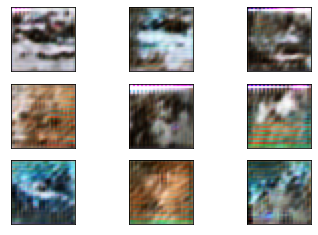

******************Epoch 82 Batch 0***************************
Real Discriminator loss: 0.5679447650909424
Fake Discriminator loss: 0.6147396564483643
Full Discriminator loss: 0.5913422107696533
Generator loss: 0.87607741355896
******************Epoch 82 Batch 1***************************
Real Discriminator loss: 0.5923523902893066
Fake Discriminator loss: 0.6435184478759766
Full Discriminator loss: 0.6179354190826416
Generator loss: 0.8798390626907349
******************Epoch 82 Batch 2***************************
Real Discriminator loss: 0.590421199798584
Fake Discriminator loss: 0.5643192529678345
Full Discriminator loss: 0.5773702263832092
Generator loss: 0.8987851738929749
******************Epoch 82 Batch 3***************************
Real Discriminator loss: 0.638745129108429
Fake Discriminator loss: 0.5956177115440369
Full Discriminator loss: 0.6171814203262329
Generator loss: 0.8823732137680054
******************Epoch 82 Batch 4***************************
Real Discriminator loss: 0

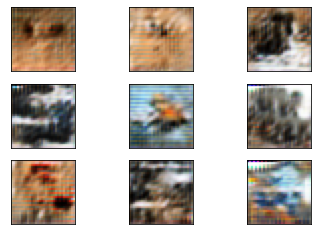

******************Epoch 83 Batch 0***************************
Real Discriminator loss: 0.5677283406257629
Fake Discriminator loss: 0.6067584753036499
Full Discriminator loss: 0.5872434079647064
Generator loss: 0.7970818877220154
******************Epoch 83 Batch 1***************************
Real Discriminator loss: 0.5912147760391235
Fake Discriminator loss: 0.627341628074646
Full Discriminator loss: 0.6092782020568848
Generator loss: 0.8271867632865906
******************Epoch 83 Batch 2***************************
Real Discriminator loss: 0.5619102716445923
Fake Discriminator loss: 0.6070753335952759
Full Discriminator loss: 0.5844928026199341
Generator loss: 0.8155444860458374
******************Epoch 83 Batch 3***************************
Real Discriminator loss: 0.5697661638259888
Fake Discriminator loss: 0.6366369128227234
Full Discriminator loss: 0.6032015383243561
Generator loss: 0.8498897552490234
******************Epoch 83 Batch 4***************************
Real Discriminator loss

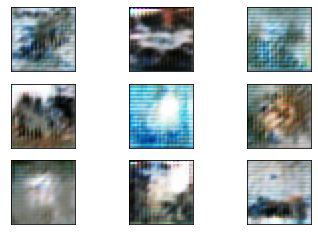

******************Epoch 84 Batch 0***************************
Real Discriminator loss: 0.5896252393722534
Fake Discriminator loss: 0.6094915270805359
Full Discriminator loss: 0.5995583832263947
Generator loss: 0.8797698020935059
******************Epoch 84 Batch 1***************************
Real Discriminator loss: 0.6601427793502808
Fake Discriminator loss: 0.5749900341033936
Full Discriminator loss: 0.6175664067268372
Generator loss: 0.8901804685592651
******************Epoch 84 Batch 2***************************
Real Discriminator loss: 0.6126630306243896
Fake Discriminator loss: 0.6136680841445923
Full Discriminator loss: 0.613165557384491
Generator loss: 0.9002419114112854
******************Epoch 84 Batch 3***************************
Real Discriminator loss: 0.656379222869873
Fake Discriminator loss: 0.6592040061950684
Full Discriminator loss: 0.6577916145324707
Generator loss: 0.9226011037826538
******************Epoch 84 Batch 4***************************
Real Discriminator loss:

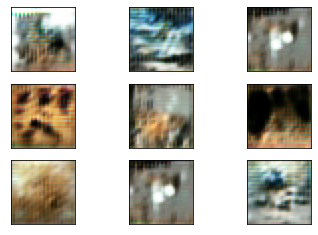

******************Epoch 85 Batch 0***************************
Real Discriminator loss: 0.5960151553153992
Fake Discriminator loss: 0.6738051176071167
Full Discriminator loss: 0.6349101364612579
Generator loss: 1.0013391971588135
******************Epoch 85 Batch 1***************************
Real Discriminator loss: 0.6391502618789673
Fake Discriminator loss: 0.5524725914001465
Full Discriminator loss: 0.5958114266395569
Generator loss: 1.0165982246398926
******************Epoch 85 Batch 2***************************
Real Discriminator loss: 0.5739609599113464
Fake Discriminator loss: 0.6095668077468872
Full Discriminator loss: 0.5917638838291168
Generator loss: 1.0280393362045288
******************Epoch 85 Batch 3***************************
Real Discriminator loss: 0.6723775267601013
Fake Discriminator loss: 0.4999438524246216
Full Discriminator loss: 0.5861606895923615
Generator loss: 1.0772795677185059
******************Epoch 85 Batch 4***************************
Real Discriminator los

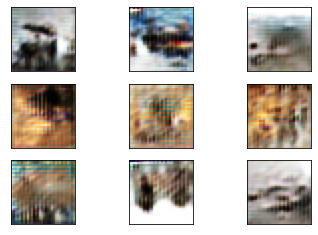

******************Epoch 86 Batch 0***************************
Real Discriminator loss: 0.738288164138794
Fake Discriminator loss: 0.5065536499023438
Full Discriminator loss: 0.6224209070205688
Generator loss: 1.0083645582199097
******************Epoch 86 Batch 1***************************
Real Discriminator loss: 0.66108638048172
Fake Discriminator loss: 0.5418820977210999
Full Discriminator loss: 0.6014842391014099
Generator loss: 1.0243116617202759
******************Epoch 86 Batch 2***************************
Real Discriminator loss: 0.7380175590515137
Fake Discriminator loss: 0.5476857423782349
Full Discriminator loss: 0.6428516507148743
Generator loss: 1.0029114484786987
******************Epoch 86 Batch 3***************************
Real Discriminator loss: 0.7010076642036438
Fake Discriminator loss: 0.616184651851654
Full Discriminator loss: 0.6585961580276489
Generator loss: 0.9507632255554199
******************Epoch 86 Batch 4***************************
Real Discriminator loss: 0

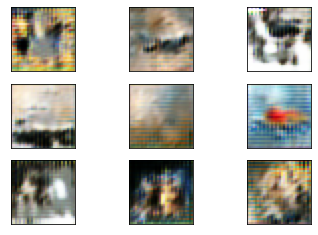

******************Epoch 87 Batch 0***************************
Real Discriminator loss: 0.6395715475082397
Fake Discriminator loss: 0.557573139667511
Full Discriminator loss: 0.5985723435878754
Generator loss: 0.9343388080596924
******************Epoch 87 Batch 1***************************
Real Discriminator loss: 0.6477005481719971
Fake Discriminator loss: 0.6285322904586792
Full Discriminator loss: 0.6381164193153381
Generator loss: 0.87899249792099
******************Epoch 87 Batch 2***************************
Real Discriminator loss: 0.5425146818161011
Fake Discriminator loss: 0.6147638559341431
Full Discriminator loss: 0.5786392688751221
Generator loss: 0.8879489898681641
******************Epoch 87 Batch 3***************************
Real Discriminator loss: 0.5849181413650513
Fake Discriminator loss: 0.5724614262580872
Full Discriminator loss: 0.5786897838115692
Generator loss: 0.892043948173523
******************Epoch 87 Batch 4***************************
Real Discriminator loss: 0

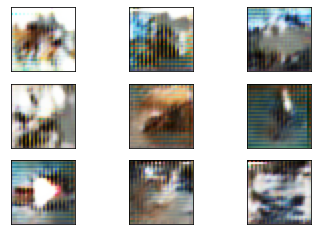

******************Epoch 88 Batch 0***************************
Real Discriminator loss: 0.5990413427352905
Fake Discriminator loss: 0.6449551582336426
Full Discriminator loss: 0.6219982504844666
Generator loss: 0.9273440837860107
******************Epoch 88 Batch 1***************************
Real Discriminator loss: 0.5909501910209656
Fake Discriminator loss: 0.6496314406394958
Full Discriminator loss: 0.6202908158302307
Generator loss: 0.8624342083930969
******************Epoch 88 Batch 2***************************
Real Discriminator loss: 0.6011035442352295
Fake Discriminator loss: 0.6264864206314087
Full Discriminator loss: 0.6137949824333191
Generator loss: 0.8598365783691406
******************Epoch 88 Batch 3***************************
Real Discriminator loss: 0.6119743585586548
Fake Discriminator loss: 0.6648328304290771
Full Discriminator loss: 0.638403594493866
Generator loss: 0.8679965138435364
******************Epoch 88 Batch 4***************************
Real Discriminator loss

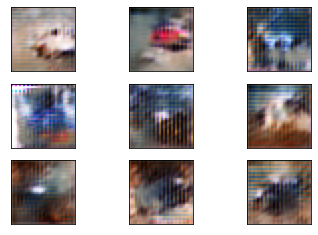

******************Epoch 89 Batch 0***************************
Real Discriminator loss: 0.5333448648452759
Fake Discriminator loss: 0.5701171159744263
Full Discriminator loss: 0.5517309904098511
Generator loss: 0.8829718828201294
******************Epoch 89 Batch 1***************************
Real Discriminator loss: 0.5340551137924194
Fake Discriminator loss: 0.6079184412956238
Full Discriminator loss: 0.5709867775440216
Generator loss: 0.9104503989219666
******************Epoch 89 Batch 2***************************
Real Discriminator loss: 0.5383397936820984
Fake Discriminator loss: 0.5995364785194397
Full Discriminator loss: 0.568938136100769
Generator loss: 0.8869422078132629
******************Epoch 89 Batch 3***************************
Real Discriminator loss: 0.5133448839187622
Fake Discriminator loss: 0.5817676186561584
Full Discriminator loss: 0.5475562512874603
Generator loss: 0.9522345066070557
******************Epoch 89 Batch 4***************************
Real Discriminator loss

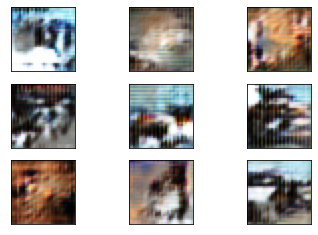

******************Epoch 90 Batch 0***************************
Real Discriminator loss: 0.544069230556488
Fake Discriminator loss: 0.6084811091423035
Full Discriminator loss: 0.5762751698493958
Generator loss: 0.9860836267471313
******************Epoch 90 Batch 1***************************
Real Discriminator loss: 0.5888832807540894
Fake Discriminator loss: 0.5801275968551636
Full Discriminator loss: 0.5845054388046265
Generator loss: 0.9943550825119019
******************Epoch 90 Batch 2***************************
Real Discriminator loss: 0.6048638820648193
Fake Discriminator loss: 0.600652813911438
Full Discriminator loss: 0.6027583479881287
Generator loss: 1.0832557678222656
******************Epoch 90 Batch 3***************************
Real Discriminator loss: 0.6713494062423706
Fake Discriminator loss: 0.5210170149803162
Full Discriminator loss: 0.5961832106113434
Generator loss: 1.009052038192749
******************Epoch 90 Batch 4***************************
Real Discriminator loss: 

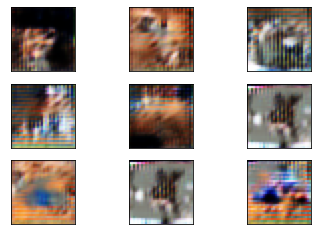

******************Epoch 91 Batch 0***************************
Real Discriminator loss: 0.549806535243988
Fake Discriminator loss: 0.6674176454544067
Full Discriminator loss: 0.6086120903491974
Generator loss: 0.8341002464294434
******************Epoch 91 Batch 1***************************
Real Discriminator loss: 0.5231389999389648
Fake Discriminator loss: 0.5536261200904846
Full Discriminator loss: 0.5383825600147247
Generator loss: 0.9205759763717651
******************Epoch 91 Batch 2***************************
Real Discriminator loss: 0.5193398594856262
Fake Discriminator loss: 0.695643424987793
Full Discriminator loss: 0.6074916422367096
Generator loss: 0.9012414216995239
******************Epoch 91 Batch 3***************************
Real Discriminator loss: 0.48221856355667114
Fake Discriminator loss: 0.6883147954940796
Full Discriminator loss: 0.5852666795253754
Generator loss: 0.9466849565505981
******************Epoch 91 Batch 4***************************
Real Discriminator loss

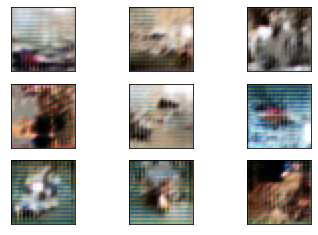

******************Epoch 92 Batch 0***************************
Real Discriminator loss: 0.5025935173034668
Fake Discriminator loss: 0.550855815410614
Full Discriminator loss: 0.5267246663570404
Generator loss: 1.0530070066452026
******************Epoch 92 Batch 1***************************
Real Discriminator loss: 0.5013144612312317
Fake Discriminator loss: 0.5407683849334717
Full Discriminator loss: 0.5210414230823517
Generator loss: 1.1260253190994263
******************Epoch 92 Batch 2***************************
Real Discriminator loss: 0.5218194127082825
Fake Discriminator loss: 0.5789281129837036
Full Discriminator loss: 0.550373762845993
Generator loss: 0.9736815094947815
******************Epoch 92 Batch 3***************************
Real Discriminator loss: 0.5090458393096924
Fake Discriminator loss: 0.528774619102478
Full Discriminator loss: 0.5189102292060852
Generator loss: 1.0206011533737183
******************Epoch 92 Batch 4***************************
Real Discriminator loss: 

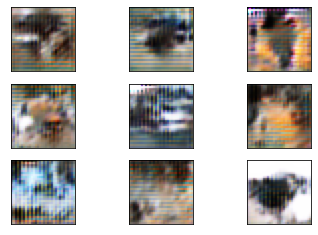

******************Epoch 93 Batch 0***************************
Real Discriminator loss: 0.6442724466323853
Fake Discriminator loss: 0.6251448392868042
Full Discriminator loss: 0.6347086429595947
Generator loss: 0.9466426372528076
******************Epoch 93 Batch 1***************************
Real Discriminator loss: 0.5828744173049927
Fake Discriminator loss: 0.6285002827644348
Full Discriminator loss: 0.6056873500347137
Generator loss: 0.9627496004104614
******************Epoch 93 Batch 2***************************
Real Discriminator loss: 0.5696460604667664
Fake Discriminator loss: 0.6206132769584656
Full Discriminator loss: 0.595129668712616
Generator loss: 0.9420197010040283
******************Epoch 93 Batch 3***************************
Real Discriminator loss: 0.6639766097068787
Fake Discriminator loss: 0.5744784474372864
Full Discriminator loss: 0.6192275285720825
Generator loss: 0.9691721796989441
******************Epoch 93 Batch 4***************************
Real Discriminator loss

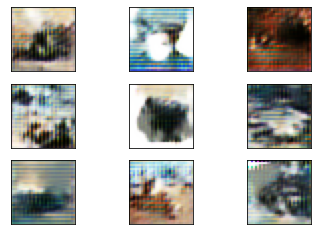

******************Epoch 94 Batch 0***************************
Real Discriminator loss: 0.683411717414856
Fake Discriminator loss: 0.5158609747886658
Full Discriminator loss: 0.5996363461017609
Generator loss: 0.9157043695449829
******************Epoch 94 Batch 1***************************
Real Discriminator loss: 0.5997976064682007
Fake Discriminator loss: 0.5822107791900635
Full Discriminator loss: 0.5910041928291321
Generator loss: 0.9476317763328552
******************Epoch 94 Batch 2***************************
Real Discriminator loss: 0.6176494359970093
Fake Discriminator loss: 0.6161358952522278
Full Discriminator loss: 0.6168926656246185
Generator loss: 0.9286350607872009
******************Epoch 94 Batch 3***************************
Real Discriminator loss: 0.6523611545562744
Fake Discriminator loss: 0.5537675619125366
Full Discriminator loss: 0.6030643582344055
Generator loss: 1.0105671882629395
******************Epoch 94 Batch 4***************************
Real Discriminator loss

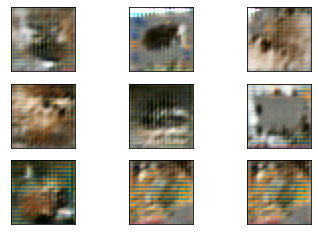

******************Epoch 95 Batch 0***************************
Real Discriminator loss: 0.5103520750999451
Fake Discriminator loss: 0.511532723903656
Full Discriminator loss: 0.5109423995018005
Generator loss: 1.0516407489776611
******************Epoch 95 Batch 1***************************
Real Discriminator loss: 0.5370817184448242
Fake Discriminator loss: 0.5356806516647339
Full Discriminator loss: 0.536381185054779
Generator loss: 1.0616185665130615
******************Epoch 95 Batch 2***************************
Real Discriminator loss: 0.5560653209686279
Fake Discriminator loss: 0.5586049556732178
Full Discriminator loss: 0.5573351383209229
Generator loss: 0.9507749080657959
******************Epoch 95 Batch 3***************************
Real Discriminator loss: 0.5634543895721436
Fake Discriminator loss: 0.5982102155685425
Full Discriminator loss: 0.580832302570343
Generator loss: 0.9822419285774231
******************Epoch 95 Batch 4***************************
Real Discriminator loss: 

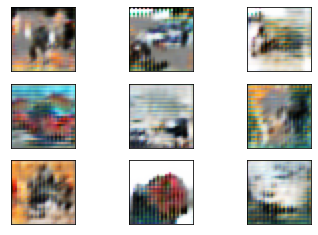

******************Epoch 96 Batch 0***************************
Real Discriminator loss: 0.5905582904815674
Fake Discriminator loss: 0.5927881002426147
Full Discriminator loss: 0.5916731953620911
Generator loss: 1.2247272729873657
******************Epoch 96 Batch 1***************************
Real Discriminator loss: 0.4940633177757263
Fake Discriminator loss: 0.5402098894119263
Full Discriminator loss: 0.5171366035938263
Generator loss: 1.1503877639770508
******************Epoch 96 Batch 2***************************
Real Discriminator loss: 0.5519313812255859
Fake Discriminator loss: 0.558323085308075
Full Discriminator loss: 0.5551272332668304
Generator loss: 1.1520874500274658
******************Epoch 96 Batch 3***************************
Real Discriminator loss: 0.6014862656593323
Fake Discriminator loss: 0.5605370998382568
Full Discriminator loss: 0.5810116827487946
Generator loss: 1.0745346546173096
******************Epoch 96 Batch 4***************************
Real Discriminator loss

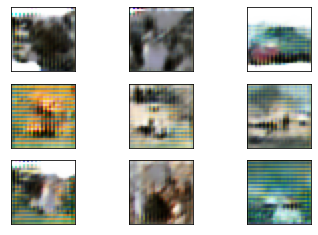

******************Epoch 97 Batch 0***************************
Real Discriminator loss: 0.6657408475875854
Fake Discriminator loss: 0.5395670533180237
Full Discriminator loss: 0.6026539504528046
Generator loss: 1.0481936931610107
******************Epoch 97 Batch 1***************************
Real Discriminator loss: 0.6804326772689819
Fake Discriminator loss: 0.5870786905288696
Full Discriminator loss: 0.6337556838989258
Generator loss: 1.0207056999206543
******************Epoch 97 Batch 2***************************
Real Discriminator loss: 0.633397102355957
Fake Discriminator loss: 0.4964783489704132
Full Discriminator loss: 0.5649377256631851
Generator loss: 1.0115374326705933
******************Epoch 97 Batch 3***************************
Real Discriminator loss: 0.6323346495628357
Fake Discriminator loss: 0.5833806991577148
Full Discriminator loss: 0.6078576743602753
Generator loss: 1.017119288444519
******************Epoch 97 Batch 4***************************
Real Discriminator loss:

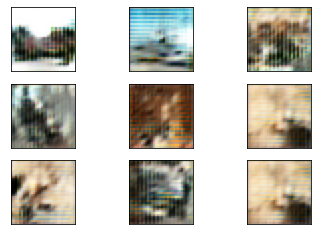

******************Epoch 98 Batch 0***************************
Real Discriminator loss: 0.5312116146087646
Fake Discriminator loss: 0.5433455109596252
Full Discriminator loss: 0.537278562784195
Generator loss: 1.0736796855926514
******************Epoch 98 Batch 1***************************
Real Discriminator loss: 0.5818776488304138
Fake Discriminator loss: 0.5565623044967651
Full Discriminator loss: 0.5692199766635895
Generator loss: 1.1231911182403564
******************Epoch 98 Batch 2***************************
Real Discriminator loss: 0.6014202237129211
Fake Discriminator loss: 0.5883218050003052
Full Discriminator loss: 0.5948710143566132
Generator loss: 1.1318576335906982
******************Epoch 98 Batch 3***************************
Real Discriminator loss: 0.5933976769447327
Fake Discriminator loss: 0.5467827916145325
Full Discriminator loss: 0.5700902342796326
Generator loss: 1.0727349519729614
******************Epoch 98 Batch 4***************************
Real Discriminator loss

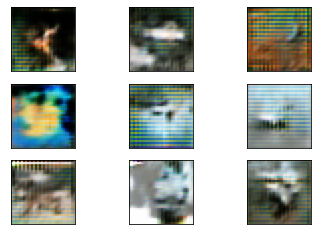

******************Epoch 99 Batch 0***************************
Real Discriminator loss: 0.6383978128433228
Fake Discriminator loss: 0.5170839428901672
Full Discriminator loss: 0.577740877866745
Generator loss: 1.0159282684326172
******************Epoch 99 Batch 1***************************
Real Discriminator loss: 0.5638976097106934
Fake Discriminator loss: 0.5374259352684021
Full Discriminator loss: 0.5506617724895477
Generator loss: 1.028619408607483
******************Epoch 99 Batch 2***************************
Real Discriminator loss: 0.5383154153823853
Fake Discriminator loss: 0.5724288821220398
Full Discriminator loss: 0.5553721487522125
Generator loss: 0.9541451930999756
******************Epoch 99 Batch 3***************************
Real Discriminator loss: 0.5804965496063232
Fake Discriminator loss: 0.5227717757225037
Full Discriminator loss: 0.5516341626644135
Generator loss: 1.030662178993225
******************Epoch 99 Batch 4***************************
Real Discriminator loss: 

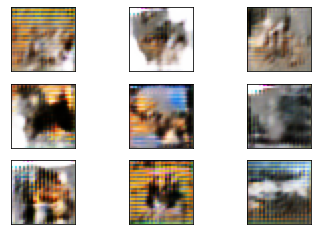

In [9]:
import matplotlib.pyplot as plt

epochs = 100
history = []
batches_per_epoch = cifar10_imgs.shape[0]//batch_size 

print(batches_per_epoch)

for epoch in range(epochs):
  #print(epoch, end=' ')
  for batch_num in range(batches_per_epoch):
    real_idx = np.random.randint(0, cifar10_imgs.shape[0], batch_size)
    real_imgs = cifar10_imgs[real_idx]
    noise_latent = np.random.normal(loc=0.0, scale=1.0, size=(batch_size, latent_dim))

    fake_imgs = gen(noise_latent)
    loss_real = dis.train_on_batch(real_imgs, real)
    loss_fake = dis.train_on_batch(fake_imgs, fake)
    discriminator_loss = 0.5 * np.add(loss_real, loss_fake)

    noise_latent = np.random.normal(loc=0.0, scale=1.0, size=(batch_size, latent_dim))
    generator_loss = gan.train_on_batch(noise_latent, real)

    print ("******************Epoch {} Batch {}***************************".format(epoch, batch_num))
    print ("Real Discriminator loss: {}".format(loss_real))
    print ("Fake Discriminator loss: {}".format(loss_fake))
    print ("Full Discriminator loss: {}".format(discriminator_loss))
    print ("Generator loss: {}".format(generator_loss))

    history.append({"Discriminator":discriminator_loss,"Generator":generator_loss})

  #After every epoch, show generated images
  
  generate_samples(3, fake_imgs)

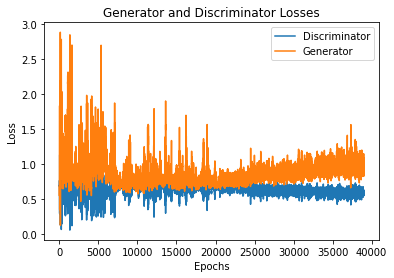

In [10]:
import pandas as pd

def plot_loss(history):
  df = pd.DataFrame(history)
  plt.figure()
  for i in df.columns:
    plt.plot(df[i], label=i)
  plt.legend()
  plt.ylabel("Loss")
  plt.xlabel("Epochs")
  plt.title("Generator and Discriminator Losses")
  plt.show()

plot_loss(history)

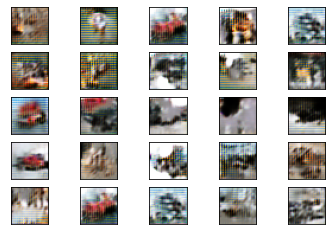

In [11]:
#Displaying 25 samples from the generated images
generate_samples(5, fake_imgs)

**Q1.7: GANs and Transfer learning**

**Part (a):**

Yes, a pre-trained VGG16 network can be used for this GAN. A pre-trained VGG16 network can either be used as a discriminator or a generator in the GAN architecture. Since GANs also use CNNs for discriminator and generator, and VGG16 is also a CNN, hence it is possible to use VGG16 with GANs.

The resulting network obtained would not be a DCGAN. This is because VGG16 network has features (such as fully connected layers) which are not in DCGANs.  However, the network can be fine-tuned and modified to be a DCGAN.

**Part (b):**
VGG16 can be thought of as a discriminative network. No, we cannot use a pre-trained VGG16 network as a generator. 

# Question 2: Reading up on GANs

**Q2.1:** SRGANs should be used in this scenario. This is because SRGANs are used for problems where high-resolution images are estimated from its low-resolution counterpart. In this scenario, we have images with a blur kernel applied to it. This is a downsampled version of the original image, and hence SRGANs can accurately approximate the high-resolution original sample from the available low-resolution images, without requiring the original images (as they are unavailable).

**Q2.2:** In this case, CGANs will be used. In this situation, we want to learn the mapping of one image to another, without the provision of direct image-to-image mapping. Conditional GANs are designed for such a purpose. Given a set of images of pandas and bears, conditional GANs are capable of finding a mapping to put the panda skin texture on bears themselves. Other approaches require a direct mapping between pandas and bears, and hence conditional GANs are better for this purpose.

**Q2.3:** Style GANs should be used in this situation. Style GANs can be used to transfer style from one sample image to the style of another image, and in this case the daughter wants to change all the family photos to Van Gogh styled images. The datasets required would be of all the family photos, and a set of images which are painted by Van Gogh. Style would be extracted from the Van Gogh paintings dataset using an encoder (which is composed of convolutional layers), and applied to the input images that need to be stylized (family photos).